# Supply Chain Managment and Logistics Course Project (APS1017)
## Group 12
### Aditya Subramaniam Sivasubramaniam-1005675789
### Mostafa Kouchakzadeh-1006131240
### Rajasekar Dhanasekar-1005672078
### Guru Raghavender Balamurugan-1006641699


#### Submitted to professor Chi-Guhn Lee 

# HOW TO USE THE NOTEBOOK
- It is recommended to use run the ipython notebook in Jupyter notebook on a PC with good powerful processor( We faced some issues with google colab(disconnection of runtime while running certain code blocks)
- Make sure all your libraries are upto date in Anaconda
- If you face issues while importing libraries or functions it is recomended to go to "ENVIRONMENT" tab in Anaconda and update index
- The program to predict output based on inputs given is under the heading **"User input, Model, Predict:"** 
- We checked the runnablity of notebook and it worked fine in 3 different PC's, if you are facing any issues with the notebook please contact our team. 

### Summary
The primary goal of the project is to forecast order quantities for the near future for a particular client and a particular material. By using the given data, i.e., past order quantities by the clients and using suitable statistical and machine learning algorithms we were able to predict the forecasted demand of the material from the client on the given date. For this project, we were given a data set containing more than 2000 data points, 10 clients, 20 materials from early December 2019 until late February. Therefore, the data set contains around 3 months of history. However, we need to consider that some of the client-material pairs did not have this number of histories given. Therefore, based on the three months' worth of data, it is logical to forecast at most  for another 3 months but this program can get input dates until the end of 2020(not recommended). Hence this code will only consider using date inputs up to 31st December 2020. The code can easily be changed to forecast far ahead but based on the history that we were given, the idea to forecast far ahead into the feuture based on only three months of data in 2020 and 2019, is not quite logical. In this project, we were asked to utilize two methods for the demand forecast for each pair of customer and material. Besides, we need to calculate the aggregated forecast if either client or material was not given by the user. In the following parts, we have analyzed the data set and understood the trend and seasonality of them. Finally, we have decided to use three methods and compare their results based on their Root Mean Square Error to see which one works better for us. This report is organized in the following order: The first section will give an introduction to the project, visualize each pair of client and material, perform some data analysis, and data visualization to better understand the information lying within the data set. The second part of the Project will introduce Winter's method and how the function associated with it is working. Giving more information about each parameter and calculation of RMSE for Winter's method can be found in this part. The thirds part of this report will discuss Linear Regression and topics associated with this method. Next, we will propose the ARIMA method. Finally, we will have a conclusion part and discuss the shortcomings associated with the data set.


### Introduction
The main goal of this project is to develop two forecasting algorithms, which would predict demand based on the users input. The data set that we are going to use in this project involves 10 clients from C1 to C10. In addition to 10 customers, we are provided with 20 different product types. The following Code is provided in a sense, which would allow the user to input his/her, data and the result for the product would be given as Order Quantity.

Fisrt we need to import all the libraries which we want to use in this project. 

In [1]:
#!pip install numpy
#!pip install pandas
#!pip install seaborn
#!pip install matplotlib
#!pip install sklearn
#!pip install statsmodels
#!pip install pmdarima
#!pip install plotly

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
! pip install pmdarima
import pmdarima as pm
from pmdarima.model_selection import train_test_split as train_test_split_arima
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from datetime import datetime
plt.style.use('fivethirtyeight')
sns.set()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import statsmodels.api as sm
import warnings
warnings.simplefilter("ignore", UserWarning)

Now, it is time to import the data set into Jupyter. As a result, the first 5 rows has been shown in the following cell.

In [3]:
#IMPORTING THE GIVEN DATA AS A PANDAS DATAFRAME
df=pd.read_csv("APS1017 Order data for Project.csv")
df.head()

,Date,Client,Order Quantity,Material
0,1/27/2020,c9,11712,12293768
1,1/15/2020,c9,6895,12246740
2,1/29/2020,c4,504,12321896
3,12/18/2019,c3,189,12042081
4,12/18/2019,c3,110,11000851


Since the Date column is considered as string, we need to change its format to date-time stamp.

In [4]:
# CREATING A COPY OF THE DATAFRAME
import copy
data_new = copy.deepcopy(df)
data_new.head()

,Date,Client,Order Quantity,Material
0,1/27/2020,c9,11712,12293768
1,1/15/2020,c9,6895,12246740
2,1/29/2020,c4,504,12321896
3,12/18/2019,c3,189,12042081
4,12/18/2019,c3,110,11000851


In [5]:
# ASSIGNING THE DATE AS THE INDEX OF THE DATA FRAME
type(df.Date)
df.index=pd.to_datetime(df["Date"])
df.head(5)

,Date,Client,Order Quantity,Material
Date,,,,
2020-01-27,1/27/2020,c9,11712,12293768
2020-01-15,1/15/2020,c9,6895,12246740
2020-01-29,1/29/2020,c4,504,12321896
2019-12-18,12/18/2019,c3,189,12042081
2019-12-18,12/18/2019,c3,110,11000851


In [6]:
date=set(df.index)
print(len(date))

65


Before jumping into modeling to forecast demand inputs, we will visualize the each pair of customer and material. We will see that we have about 118 pairs of customers and material. In our data set, we have some date, which include multiple order for certain product for a specific customer. Thus, we have used groupby method to sum all of those into one specific data point for better visualization.

#### WARNING THE FOLLOWING SET OF CODE (3 CODE BLOCKS) PLOTS THE DATA FOR ALL CLIENT AND MATERIAL CODE, THESE BLOCKS ARE TO BE RUN ONLY IN A POWERFUL PC (PREFERABLY IN JUPYTER NOTEBOOK(DO NOT USE COLAB))

In [7]:
data_new['Date']= pd.to_datetime(data_new['Date']) 
data_new['Material'] = data_new['Material'].apply(str)
clients = data_new.Client.unique()

C:\Users\aditya\Anaconda3\lib\site-packages\pandas\plotting\_converter.py:129: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



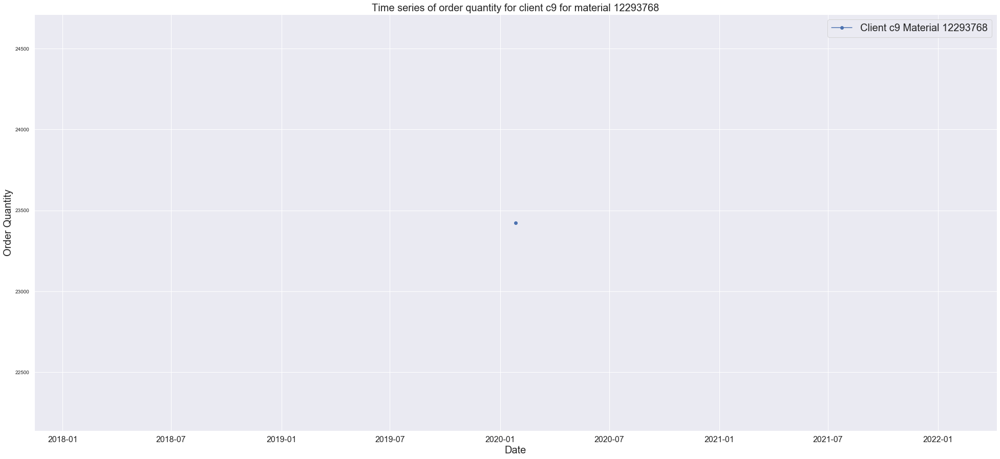

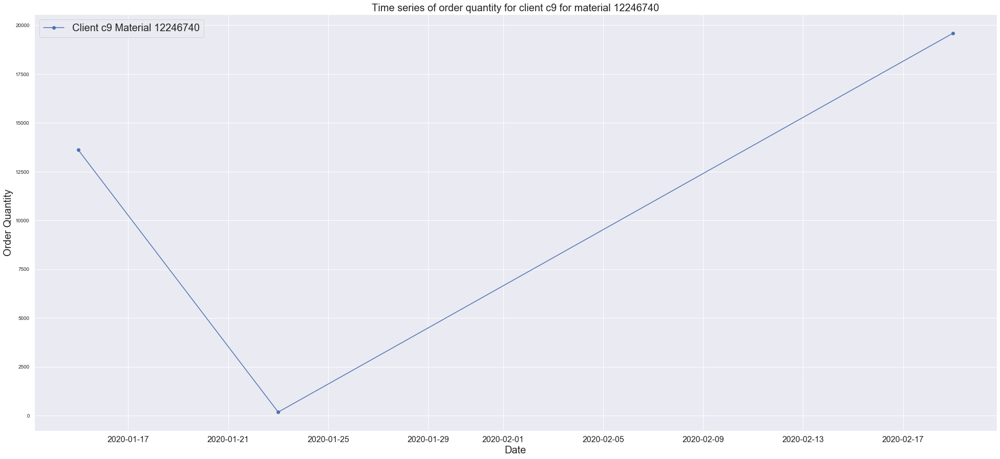

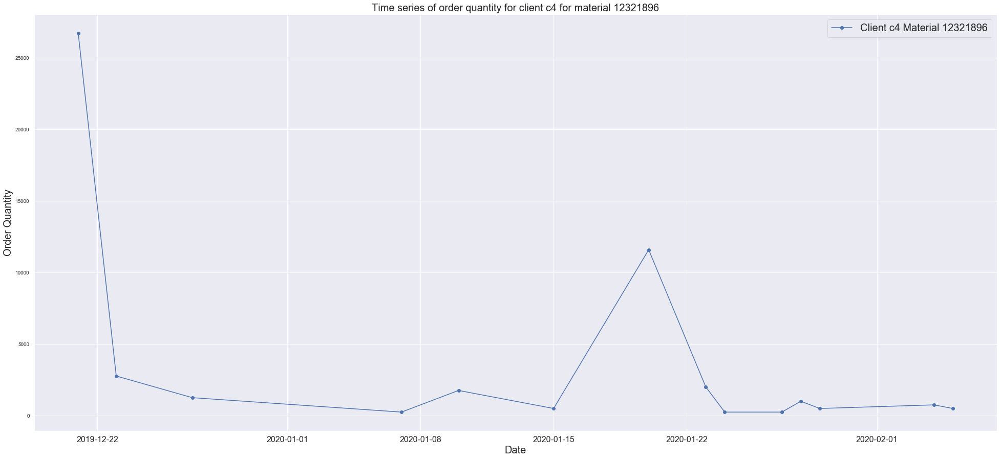

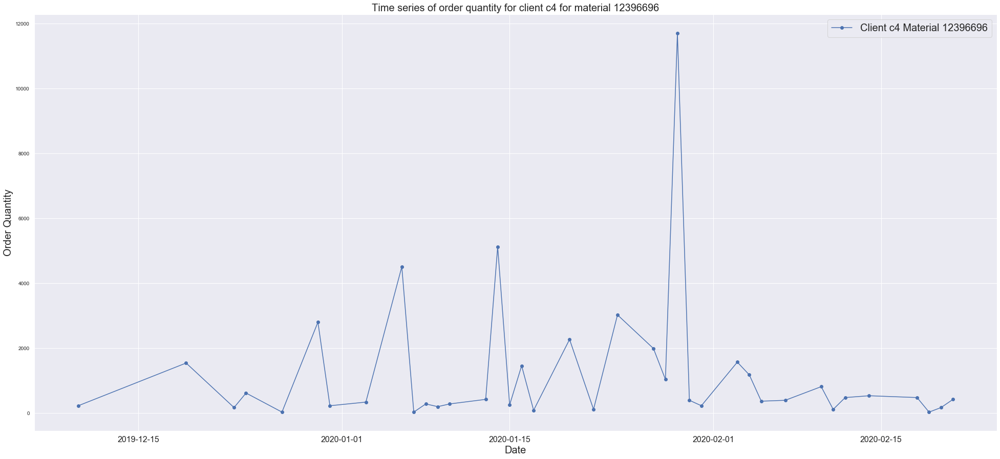

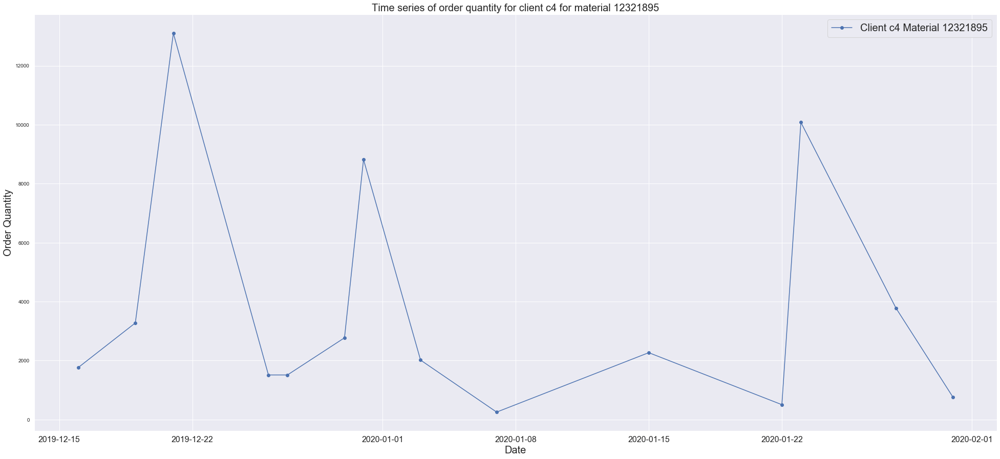

...

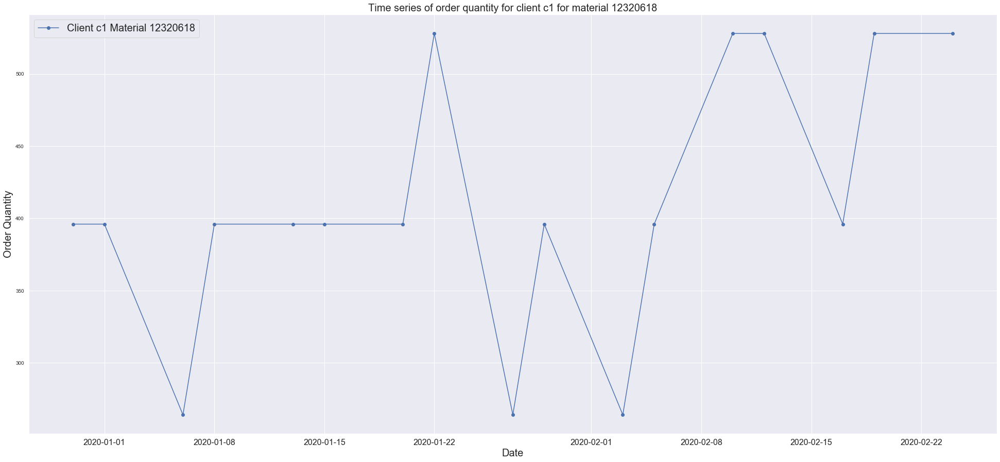

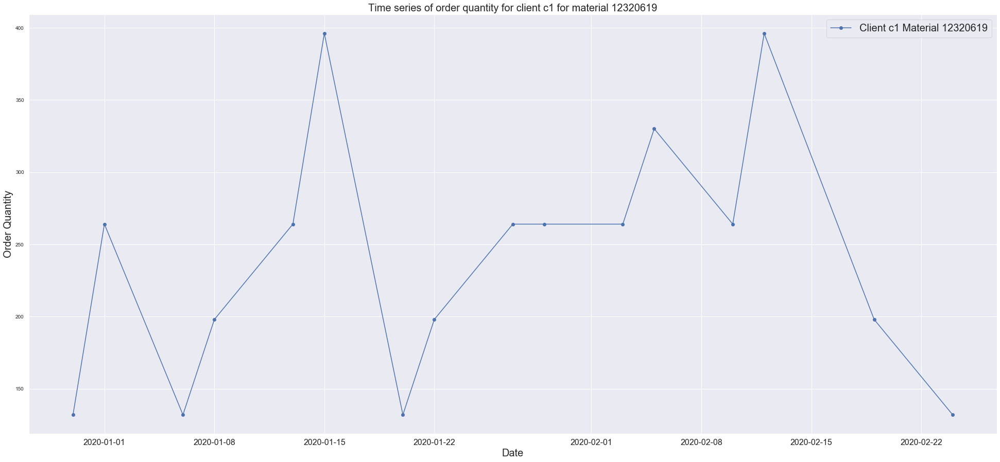

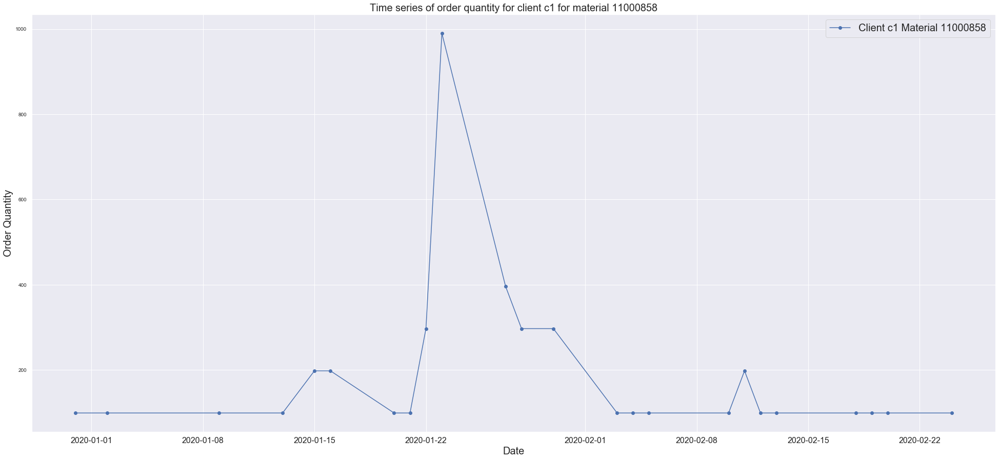

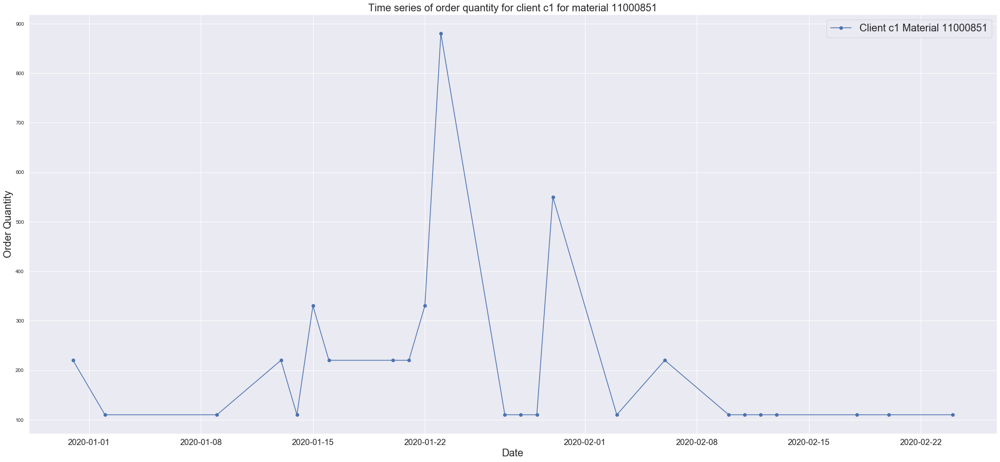

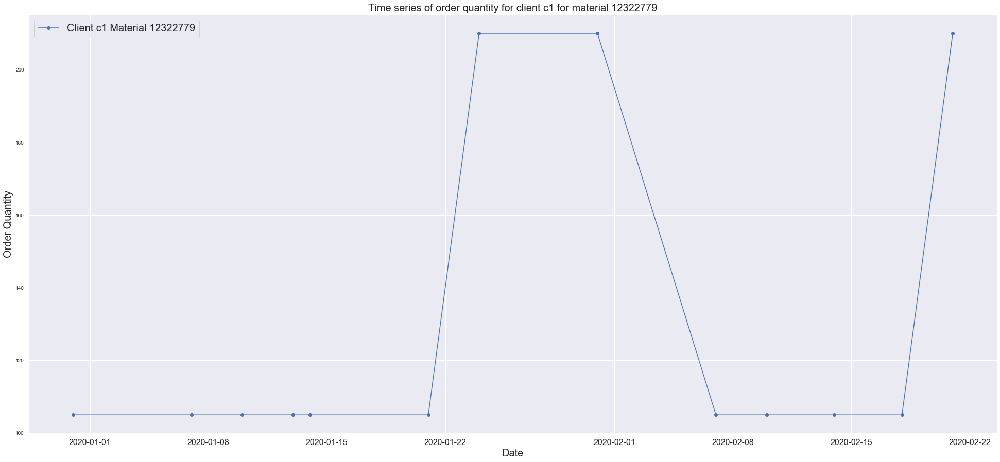

In [8]:
for client in clients:
    df_new=data_new.loc[data_new['Client'] == client]
    materials = df_new.Material.unique()
    for material in materials:
        df_new_1 = df_new.loc[df_new['Material'] == material]
        df_new_1 = df_new_1.groupby(['Date','Material'], as_index=False)['Order Quantity'].sum()
        '''r = pd.date_range(start=df_new_1.Date.min(), end=df_new_1.Date.max())
        df_new_1 = df_new_1.set_index('Date').reindex(r).fillna(0).rename_axis('Date').reset_index()'''
        plt.figure(figsize=(30, 15))
        # plot
        plt.plot( 'Date', 'Order Quantity', data=df_new_1, linestyle='-', marker='o')
        plt.title("Time series of order quantity for client " + client + ' for material ' + material, fontsize=20)
        plt.xlabel("Date" ,fontsize=20)
        plt.ylabel("Order Quantity",fontsize=20)
        plt.xticks(fontsize=16)
        plt.yticks(fontsize=10)
        plt.legend(['Client '+ client + " Material "+ material], prop={"size":20})
        plt.show()

Based on the graphs shown above, we will have 118 pairs of client and customers. Some customers are not consumer for certain products. In addition, some of the data points only have one specific demand during the period of data set.
  
   For instance let us take a closer look at the pair of customer C9 and material ID 12293768(FIRST PLOT), we can see there is only one order has been submitted with order quantity of 23500 on January 27th 2020. This would significantly increase the error with our forecast in the following models. For customer C4 and material ID 12321896, we can see there are two peak points in the orders on January 20th and December 21st 2019. 
   
   It would make more sense if we include more data points in our time series and do the forecast in aggregated data points. It is worth mentioning that since the order dates does not follow any specific pattern and are not equally distanced, it is better to include all the dates in between to which do not have any submitted order. This would will help our model perform better. Now since we convert the data to daily data we will be using 7 days as seasonal period in our models. 
   
   As we can see in the plotted graphs, most of the pairs do not have many data points, which would lead to lower accuracy in time series analysis. As the last example, if we look into material 12404641 and customer ID C6, we will see it has a stationary demand of 392 during all periods. In order to use Winter's method we will include all the date in between which do not have any orders. 
   
   Inorder to overcome this problem we impute a value of 0 for all dates with no order.Plots are shown below.

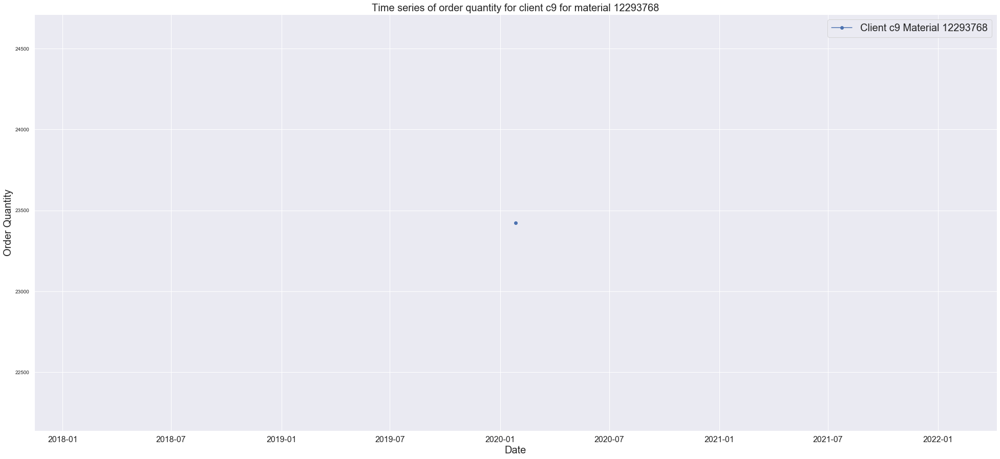

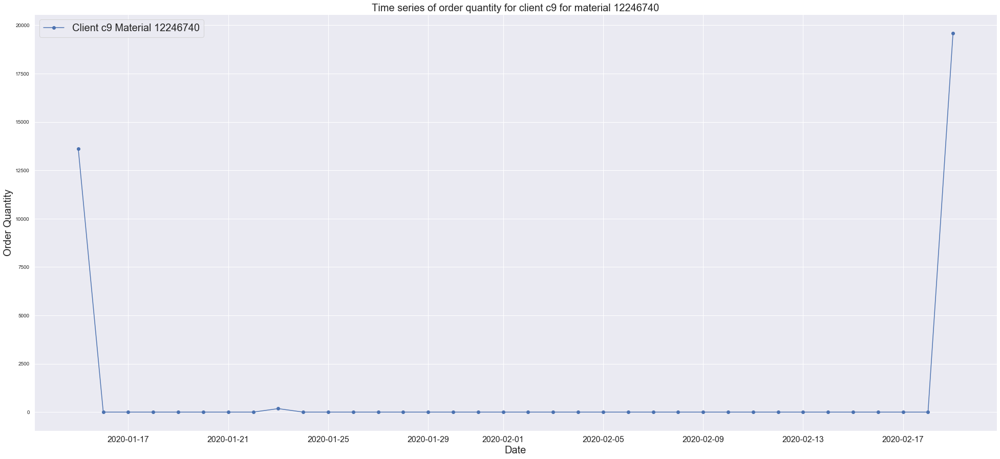

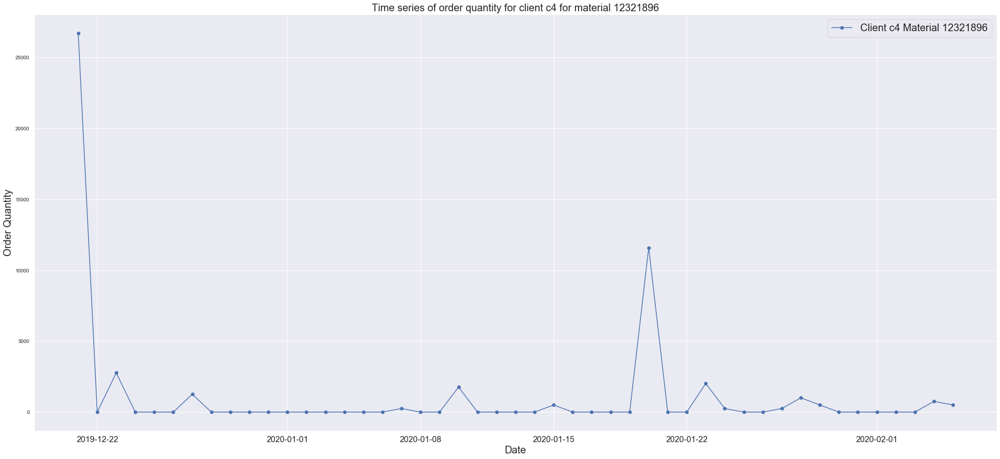

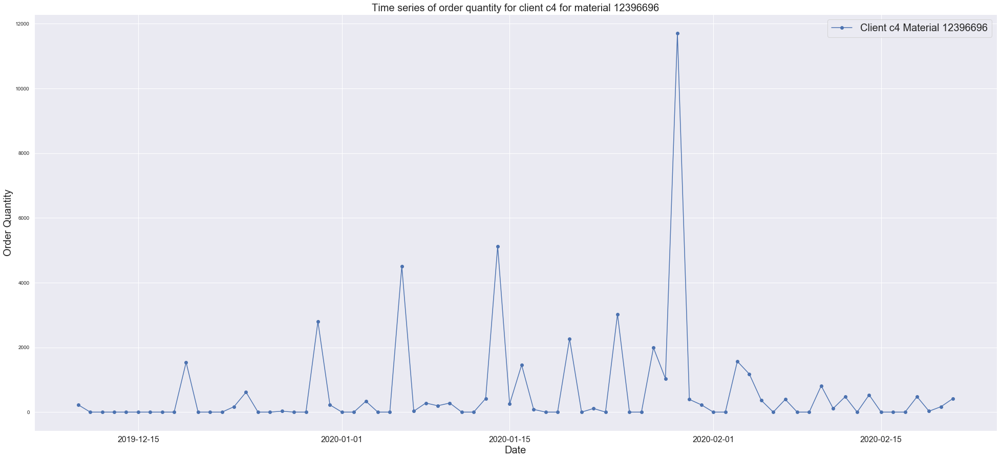

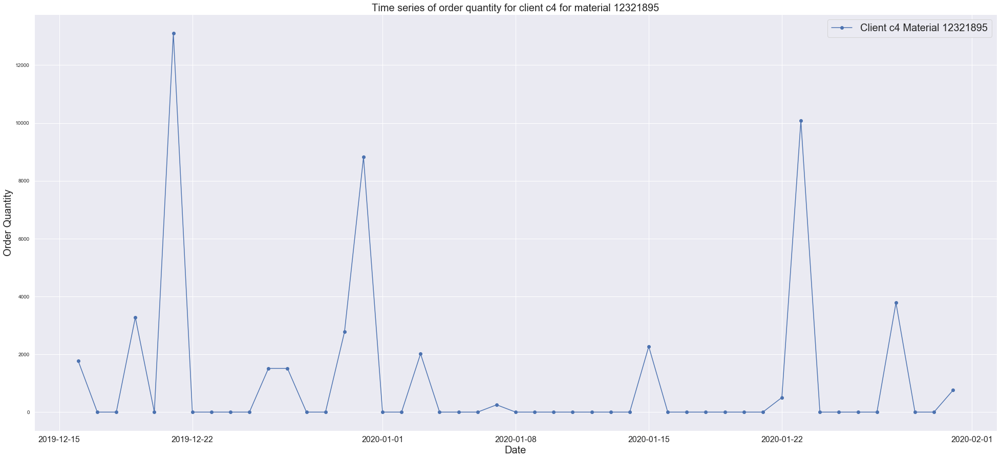

...

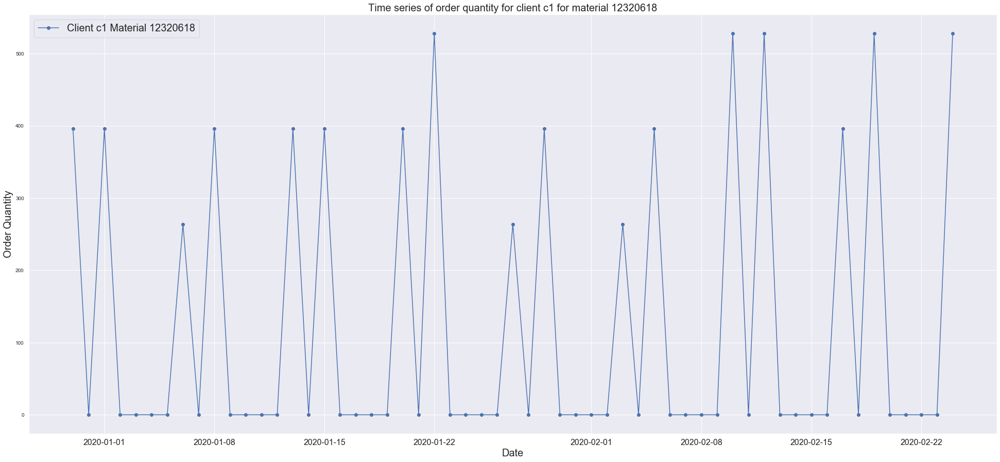

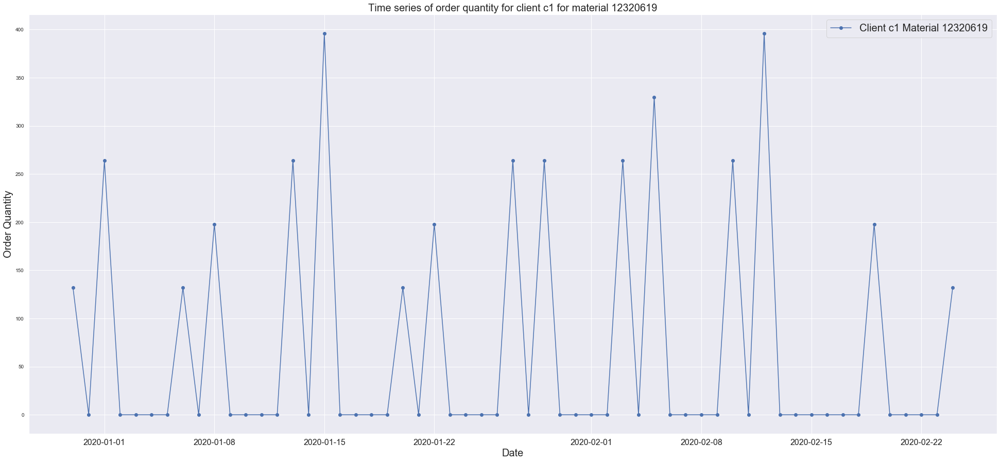

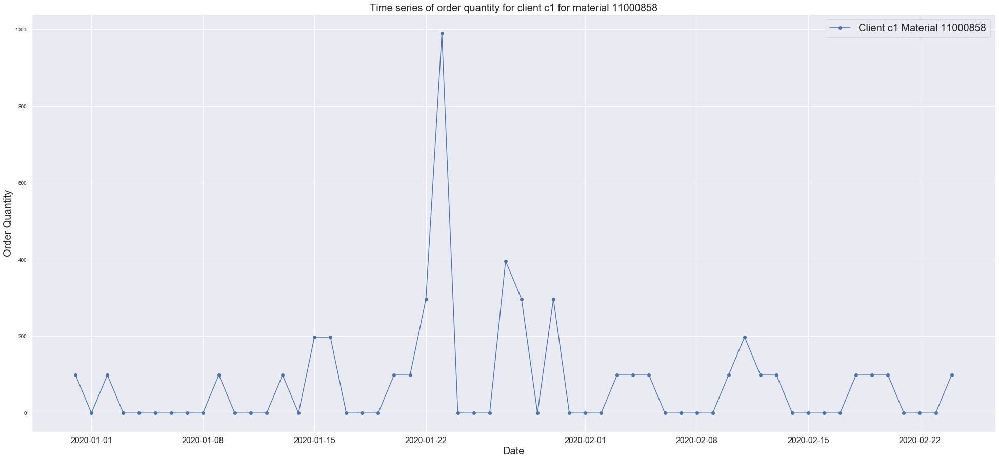

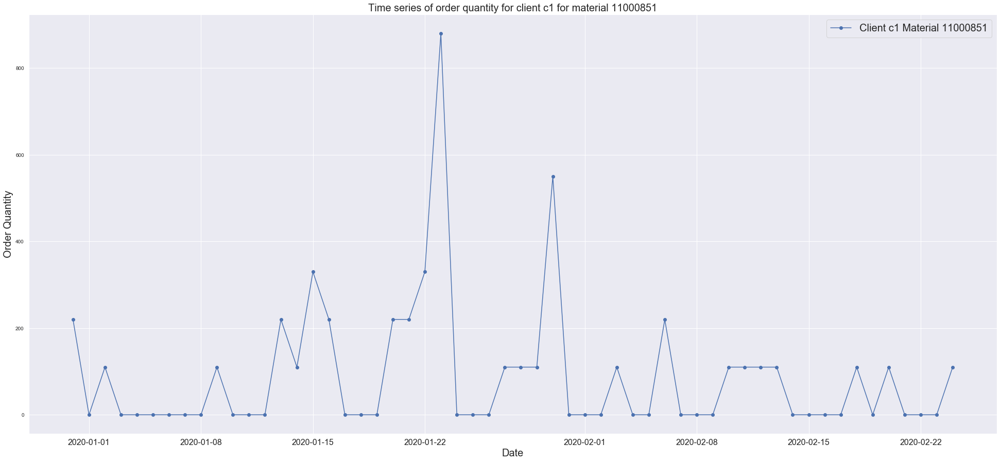

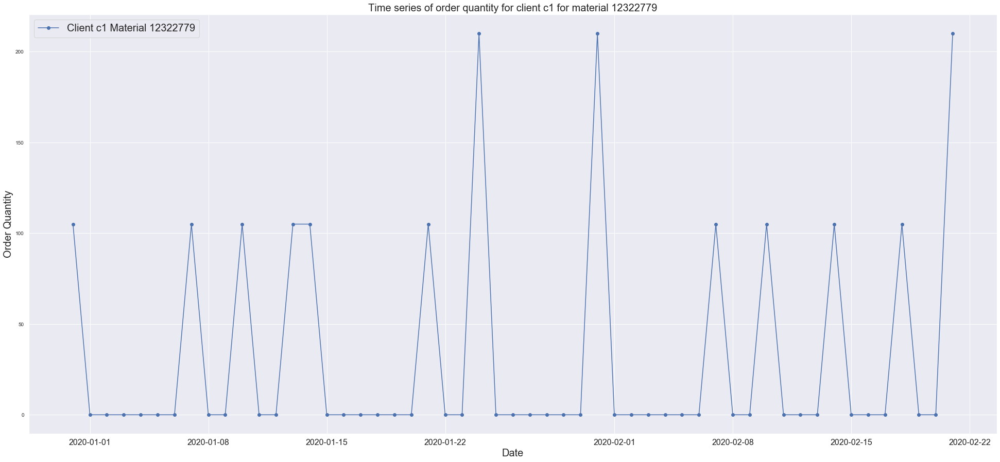

In [9]:
for client in clients:
    df_new=data_new.loc[data_new['Client'] == client]
    materials = df_new.Material.unique()
    for material in materials:
        df_new_1 = df_new.loc[df_new['Material'] == material]
        df_new_1 = df_new_1.groupby(['Date','Material'], as_index=False)['Order Quantity'].sum()
        r = pd.date_range(start=df_new_1.Date.min(), end=df_new_1.Date.max())
        df_new_1 = df_new_1.set_index('Date').reindex(r).fillna(0).rename_axis('Date').reset_index()
        plt.figure(figsize=(30, 15))
        # plot
        plt.plot( 'Date', 'Order Quantity', data=df_new_1, linestyle='-', marker='o')
        plt.title("Time series of order quantity for client " + client + ' for material ' + material, fontsize=20)
        plt.xlabel("Date" ,fontsize=20)
        plt.ylabel("Order Quantity",fontsize=20)
        plt.xticks(fontsize=16)
        plt.yticks(fontsize=10)
        plt.legend(['Client '+ client + " Material "+ material], prop={"size":20})
        plt.show()

Lets take one Client and material code and process the data to get a good time series 

We do the following processing:
- In our time series we have some dates with more than one order quantity and most of the time they are the same value(DUPLICATES).We consider them as duplicates and drop all values except the 1st one for the specific date
- Next we have order quantities for just few dates and the rest of the dates are empty. This means the order quantity is zero for those dates with no order quantity. We impute the value of 0 for those dates
- Finally the dates are not in ordered sequence so we set the index of dataframe as dates which automatically sets data in order 


In [10]:
# EXAMPLE
c="c8"
m=12293768

In [11]:
#EXTRACTNG THE DATA OF A SINGLE CLIENT AND MATERIAL CODE
dff=df[df["Client"]==c]
dff1=dff[dff["Material"]==m]

# dropping duplicates
dff2=dff1.index.drop_duplicates()
dff2=dff1.loc[~dff1.index.duplicated(keep='first')]

#Upsampling time
dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
r=pd.DataFrame(index=dte)
r1=r.merge(dff2,left_index=True, right_index=True,how='outer')
r1=r1.fillna(0)

c= c8
m= 12293768


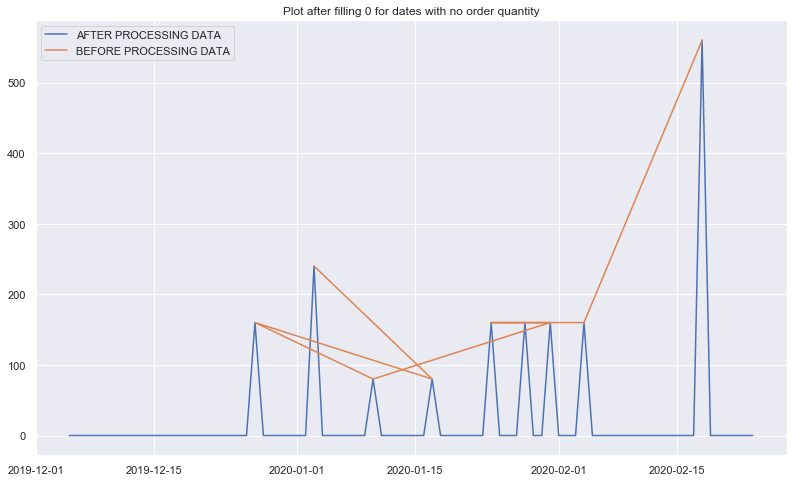

In [12]:
#PLOTTING DATA AFTER PROCESSING
print("c=",c)
print("m=",m)
plt.figure(figsize=(12,8))
plt.plot(r1["Order Quantity"])
plt.plot(dff2["Order Quantity"])
plt.title("Plot after filling 0 for dates with no order quantity")
plt.legend(["AFTER PROCESSING DATA","BEFORE PROCESSING DATA"])

plt.show()

We can see that the processed data is in ordered sequence with value for each date

Lets now decompose the time series into different components. In order to decide which methods we need to use for our demand forecast first we should decompose the time series into its main components. We need to know whether the data is stationary non-stationary. For instance if the demand follows seasonal patter, we cannot use single exponential smoothing. Therefore, using the following code we are going to decompose one sample. 


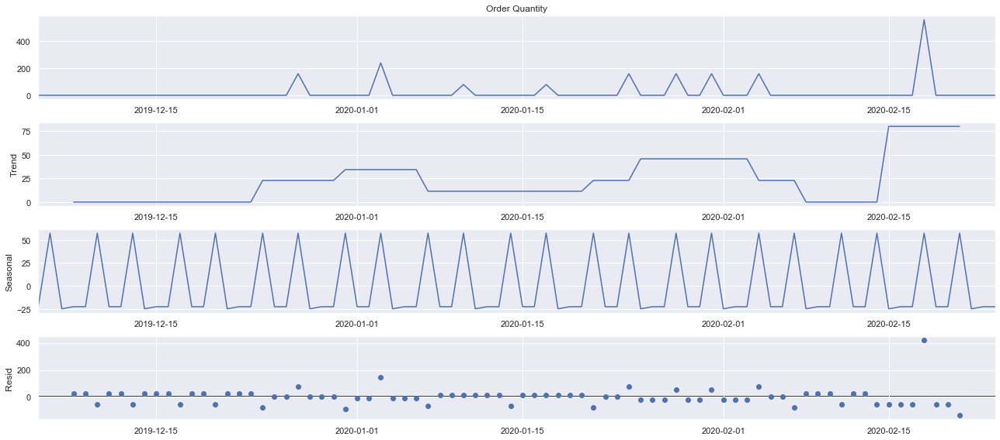

In [13]:
#DECOMPOSING DATA INTO TREND AND SEASONALITY
import statsmodels.api as sm
from pylab import rcParams
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(r1["Order Quantity"], model='additive')
fig = decomposition.plot()
plt.show()

As we can see above our time series has both trend and seasonality. However, it does not follow any specific patter, i.e increasing or decreasing pattern. In the following parts, we need to specify at least two methods for our demand forecast. One of which should include one of the methods which was taught in the class. For this project we have decided to choose one of the exponential smoothing techniques. There are three exponential smoothing methods including, single exponential smoothing, double exponential smoothing, and last but not least triple exponential smoothing. But let us discuss each in summary to see which one fits our data the best. Exponential smoothing is a technique which uses exponential window function to smooth the time series data. To be more specific, the idea behind exponential smoothing is to forecast the demand in future based on the weighted average of last forecast and the most recent observation. nevertheless, this simple description fits the idea behind single exponential smoothing. If the data follows a trend or seasonality, we cannot use single exponential smoothing as it would not lead to accurate result. If the data only follows a trend and not seasonality we can take advantage of double exponential smoothing which has two smoothing equations. One for the series and one for the trend the data follows. The last and most complicated smoothing technique is called triple exponential smoothing. Triple exponential smoothing applies exponential smoothing three times, one for series, one for trend and the last one is for the seasonality in the demand. Winter's method which is based on the triple exponential smoothing would be the best fit for our data set. We also want to use two other methods to compare the results and understand which method has the lowest root mean square error for our data set. 

We are going to use three methods for forcasting
- Winters method
- Linear regression
- ARIMA



  For the given input of material and client we extract the data for those client and material and impute zero value for dates with no order quantity.

  
  Now we apply the above models for the time series of given material and client. Then we Forecast with the same model for the given future date 

Before starting to go through the methods, we would like to take a deeper look into the data set to better understand the behavior of each customer regarding each material type. Therefore, we will write a code to calculate the average, minimum and maximum of order quantities.

In [14]:
df_new = pd.read_csv('APS1017 Order data for Project.csv')
df_new['Date']= pd.to_datetime(df_new['Date']) 
df_new['Material'] = df_new['Material'].apply(str)
df_new = df_new.groupby(['Date','Material','Client'], as_index=False)['Order Quantity'].sum()

In [15]:
# Sales distribution across the data set
def sales_dist(data):
    sales_df = data.copy(deep=True)
    sales_df['sales_bins'] = pd.cut(sales_df['Order Quantity'], [0, 500, 1000, 1500, 2000, 2500])
    print('Max sale:', sales_df['Order Quantity'].max())
    print('Min sale:', sales_df['Order Quantity'].min())
    print('Avg sale:', sales_df['Order Quantity'].mean())
    print()
    return sales_df

sales_df = sales_dist(df_new)

# Total number of data points
total_points = pd.value_counts(sales_df.sales_bins).sum()
print('Sales bucket v/s Total percentage:')
display(pd.value_counts(sales_df.sales_bins).apply(lambda s: (s/total_points)*100))

Max sale: 26712
Min sale: 10
Avg sale: 426.13002364066193

Sales bucket v/s Total percentage:


(0, 500]        84.045756
(500, 1000]     11.137869
(1000, 1500]     3.130644
(1500, 2000]     1.143889
(2000, 2500]     0.541842
Name: sales_bins, dtype: float64

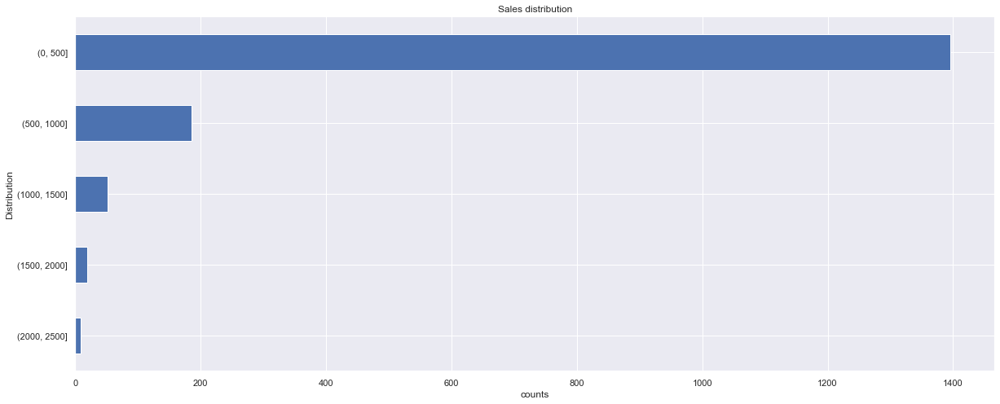

In [16]:
# Let us visualize the same
sales_count = pd.value_counts(sales_df.sales_bins)
sales_count.sort_values(ascending=True).plot(kind='barh', title='Sales distribution');
plt.xlabel("counts")
plt.ylabel("Distribution")
plt.show()
# sns.countplot(sales_count)

From the calculations presented above, we can see around 95 percent of order quantities are less the 1000. However, we can see that the maximum order quantity is about 26712, which is significantly higher than most of order quantities. We will go deeper in details to see which client have this amount of order quantity. 

In [17]:
# Let us understand the Order Quantity data distribution across the clients
def sales_data_understanding(data):    
    store_df = data.copy()
    sales_pivoted_df = pd.pivot_table(store_df, index='Client', values=['Order Quantity','Date'], columns='Material', aggfunc=np.mean)
    sales_pivoted_df=sales_pivoted_df.fillna(0)
    # Pivoted dataframe
    print("AVERAGE ORDER QUANTITY \n")
    display(sales_pivoted_df)
    return (store_df,sales_pivoted_df)

store_df,sales_pivoted_df = sales_data_understanding(df_new)

AVERAGE ORDER QUANTITY 



Order Quantity                                               \
Material       11000851    11000858    11001186    12042081 12160666   
Client                                                                 
c1           206.250000  185.625000  401.333333  341.250000      0.0   
c10          292.875000  360.642857  256.666667  385.000000      0.0   
c2           332.750000  193.050000  192.315789  204.400000      0.0   
c3            83.695652  101.200000  154.736842  122.181818      0.0   
c4             0.000000    0.000000    0.000000    0.000000      0.0   
c5           385.916667  303.416667  504.000000  189.000000      0.0   
c6           170.500000  141.428571  140.700000  127.750000      0.0   
c7           403.333333  261.642857  378.000000  320.727273    105.0   
c8           990.000000  712.800000  220.500000  648.000000      0.0   
c9             0.000000    0.000000    0.000000    0.000000      0.0   

                                                                           \
Material    12222902      12246740     12271469      12293768    12293783   
Client                                                                      
c1        228.413793    221.000000   367.125000    118.695652  304.363636   
c10       168.000000      0.000000   683.500000    172.222222  132.428571   
c2        243.096774    152.941176   625.680000    256.000000  188.608696   
c3        186.181818    136.000000   221.913043    120.000000  201.913043   
c4          0.000000      0.000000     0.000000      0.000000    0.000000   
c5        110.823529     98.600000  1192.714286      0.000000  344.000000   
c6        192.000000     78.000000   264.000000     98.000000  118.800000   
c7        202.000000     65.000000  1010.625000    136.000000  200.571429   
c8        277.333333    104.000000     0.000000    195.555556  151.200000   
c9          0.000000  11126.666667     0.000000  23424.000000    0.000000   

                                                                            \
Material    12320618    12320619    12320670 12321895 12321896    12322779   
Client                                                                       
c1        411.529412  239.250000  287.294118      0.0      0.0  129.230769   
c10         0.000000  198.000000  165.000000      0.0      0.0  742.000000   
c2        227.333333  281.600000  278.666667      0.0      0.0  433.636364   
c3        348.700000  280.500000  243.375000      0.0      0.0  187.500000   
c4          0.000000    0.000000    0.000000   3744.0   3582.0    0.000000   
c5          0.000000    0.000000    0.000000      0.0      0.0  446.538462   
c6        633.600000  620.400000  557.333333      0.0      0.0  105.000000   
c7        463.466667  383.428571  353.571429      0.0      0.0  972.444444   
c8        458.117647  610.500000  667.764706      0.0      0.0  777.000000   
c9          0.000000    0.000000    0.000000      0.0      0.0    0.000000   

                                                            
Material     12365978    12395525     12396696    12404641  
Client                                                      
c1           0.000000  385.411765     0.000000  213.703704  
c10          0.000000  273.000000     0.000000   37.333333  
c2           0.000000  192.230769     0.000000  343.000000  
c3           0.000000  336.000000     0.000000  263.846154  
c4        1428.428571    0.000000  1206.210526    0.000000  
c5           0.000000    0.000000     0.000000  952.000000  
c6           0.000000  234.181818     0.000000  392.000000  
c7           0.000000    0.000000     0.000000  212.000000  
c8           0.000000   42.000000     0.000000  140.000000  
c9           0.000000    0.000000     0.000000    0.000000

From the table, we can see although client 9 only has two materials of interest, the average of these two materials is significantly higher than the most of population. Thus, we will drop client 9 for the interactive scatter plot that we want to show in the following section. In the next part, we can see how the average order quantities change among customers. In addition, we can interpret from the above-shown graph that material 12246740 has the lowest frequency of orders even though its average is quite higher than the others.

In [18]:
x = df.Material.unique()
average_mat=[]
mater=[]

In [19]:
for mat in x:
    avg = df.loc[df['Material']== mat]
    avg_mat= avg['Order Quantity'].mean()
    average_mat.append(avg_mat)
    mater.append(mat)

In [20]:
columns_names = ['Material','Average']

average_material = pd.DataFrame(columns = columns_names)

In [21]:
average_material['Material'] =mater
average_material['Average'] =average_mat

In [22]:
# And finally, sort by avg sale
average_material.sort_values(by='Average', ascending=False, inplace=True)
average_material['Material'] = average_material['Material'].apply(str)
# Display the top 10 rows
average_material.reset_index()

,index,Material,Average
0,2,12321896,1166.232558
1,17,12321895,1115.234043
2,18,12365978,606.000000
3,1,12246740,425.641509
4,12,12271469,317.093923
5,7,12322779,288.041096
6,16,12396696,281.202454
7,0,12293768,250.222222
8,13,12320618,241.861635
9,14,12320670,229.842105


Text(0.5, 1.0, 'Average Order Quantity among different materials')

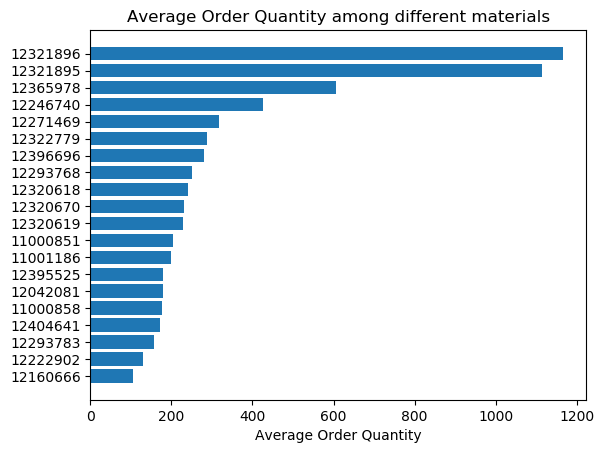

In [23]:
plt.rcdefaults()
fig, ax = plt.subplots()

ax.barh(average_material.Material, average_material.Average,)
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Average Order Quantity')
ax.set_title('Average Order Quantity among different materials')


From the Graph we can see that material 12321896 has the highest demand and material 12160666 has the lowest one.

# METHOD 1-WINTER METHOD:


**Winter’s Method (Triple Exponential Smoothing)**

Generally, there are two methods of forecasting based on time series data. One is Method for Stationary series and the next one is method for Non-Stationary series with trend. In this forecasting project, we have used Winter’s method as one of our approaches for forecasting a real-time industrial data with client names, material codes and the order dates. Winter’s method is also known as Triple Exponential Smoothing Method where three smoothing equations are used to forecast future demands, provided that the series is non-stationary and seasonal i.e., repetitive over some time period. This method is sometimes called Holt-Winters Exponential Smoothing, named after two contributors to the method: Charles Holt and Peter Winters. Usually, Moving Averages and Single/Double Exponential smoothing methods uses series factor and trend factors into their accounts in order to forecast. The Triple Exponential Smoothing technique filters the above two factors and also considers the seasonality factor and smooths them to forecast the future data accurately.

**Basic Concept**

In general, in exponential smoothing method, the recent observed values are more valuable for future prediction than the earlier observed. In non-stationary series the forecast is estimated by the weighted average of last forecast and the most recent observation. Exponential Smoothing takes into effect the most recent observations and weights them accordingly to their time period. For example, if a data is taken from January, February and March of 2020 and other set of data taken from April, May and June of 2020, then the values of April, May and June is more likely to be weighted more when compared to data collected from January, February and March of 2020. This concept of weighted technique is expected to give more accurate result irrespective of the range of time horizon.

**Modelling of Seasonality**

As Triple Exponential Smoothing technique unanimously involves seasonality factor, this seasonality can be modelled either as an additive seasonality or multiplicative seasonality. Additive seasonality model refers to the triple exponential smoothing with linear seasonality and multiplicative model refers to the same smoothing technique with exponential seasonality. However, both seasonality trends seem to be impressive, the multiplicative seasonality trend seems to be more probable to real-life applications. It is possible to derive single and double exponential smoothing from Triple exponential smoothing technique. In addition, to make this modelling technique to be effective, the time steps in seasonal period has to be specified. For example, if the series data is captured daily and the seasonal period is repeated each week, then the Period=7.

**Smoothing Equations for multiplicative seasonality**

**Series:** 

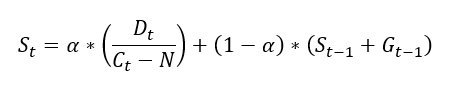

**Trend:**

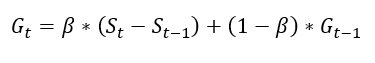

**Seasonal-Factor:**

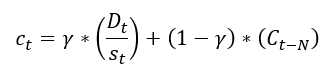

**Forecast:**

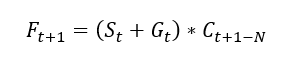

**Smoothing Equations for additive seasonality**

**Series:** 

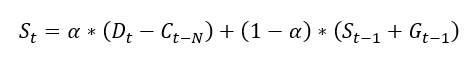

**Trend:**

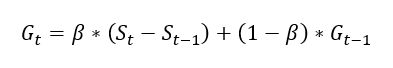

**Seasonal-Factor:**

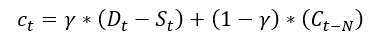

**Forecast:**

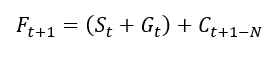

Where,

	α – smoothing factor for series
	β – smoothing factor for trend
	γ – smoothing factor for seasonal
	S – Smoothed Observation
	G – Trend Factor
	C – Seasonal Index
	F – Forecast at specific time periods
	t – Time Index
	N – Length of a cycle


### MAJOR FUNCTIONS USED:(WINTER'S METHOD)
 For winters method we will be using the exponential smoothing function from stats model library in python

from **statsmodels.tsa.holtwinters** import **ExponentialSmoothing**

The exponnetial smoothing function can have the following inputs

ExponentialSmoothing(endog, trend=None, damped=False, seasonal=None, seasonal_periods=None, dates=None, freq=None, missing='none')

**endog:**Time series data

**trend:**Type of trend component.

{“add”, “mul”, “additive”, “multiplicative”, None}, 

**damped:**Should the trend component be damped.

{"True","False"}

**seasonal:**Type of seasonal component.

{“add”, “mul”, “additive”, “multiplicative”, None}, optional


**seasonal_periods:**The number of periods in a complete seasonal cycle, e.g., 4 for quarterly data or 7 for daily data with a weekly cycle.

**Returns**

**results:**ExponentialSmoothing class


For our model, we used the following parameters. Based on the decomposition of the data set we saw that the data follow seasonality. The visualization helps us to understand the seasonal period which is a week or 7 days. For dates, we have used r1.index which is all days from December 5th, 2019 until February 24th, 2020. The data follows the trend and we have decided to go with add trend component. We also realized that the trend should be damped. Similar to trend we set seasonality parameter as add. Final result has been shown below:


***ExponentialSmoothing(train, trend="add", damped=True, seasonal="add", seasonal_periods=7, dates=r1.index, freq=None, missing='none')***


  The following function **def winter** was created to extract the data of the given client and material and also train the model by splitting the available data into train and test data. It also calculates the RMSE of the model for the specific material and client based on test data. It is worth mentioning that the test set would include 20 percent of all data points. First we are going to train the model and based on the test data set, we can calculate the root mean square error to observe the efficiency of the model.
In the first stage, based on the input, we will have sub data set by equating the value of customer and material. Then the sub data set will be divided into train and test. 
  The function returns the RMSE data, Trained Model and also a dataframe with the data for only the given client and material code

In [24]:
def winter(df,c,m):
  dff=df[df["Client"]==c]
  dff1=dff[dff["Material"]==m]
  
  # dropping duplicates
  dff2=dff1.index.drop_duplicates()
  dff2=dff1.loc[~dff1.index.duplicated(keep='first')]

  #Upsampling time
  dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
  r=pd.DataFrame(index=dte)
  r1=r.merge(dff2,left_index=True, right_index=True,how='outer')
  r1=r1.fillna(0)

  #Mapping dates
  dte1=np.arange(1,len(dte)+1,1)
  d={}
  d = dict(zip(dte, dte1))
  r1["date_en"]=r1.index.map(d)
  x=r1["Order Quantity"]

  #Splittinng the data into train and test
  train, test = train_test_split_arima(x, train_size=0.80)

  #AUTO TRIPLE EXPONENTIAL SMOOTHING IMPLEMRNTATION
  model = ExponentialSmoothing(train, trend="add", damped=True, seasonal="add", seasonal_periods=7, dates=r1.index, freq=None, missing='none')
  model_fit = model.fit()

  # FORECASTING TEST DATA TO CALCULATE ROOT MEAN SQUARED ERROR
  forecasts = model_fit.forecast(test.shape[0])  # predict N steps into the future
  
  # ROOT MEAN SQUARED ERROR
  rmse = np.mean((np.array(forecasts) - test)**2)**.5
  print("ROOT MEAN SQUARED ERROR",rmse)

  return (r1,model_fit,rmse)

## RMSE FOR MODEL:
  Before we move to the forcasting part lets find the model's performance for different material and client code.
  
  Since we have to predict a continuous data we cannot use accuracy(used for CATEGORICAL DATA)as performance metric.
  
  
  We will go with ROOT MEAN SQUARED ERROR to know the performance of the model across different client and material code. The following set of code goes through all the combinations of client-material and calculate RMSE. Therefore, it will be a somewhat time consuming.

In [25]:
# MASTER LISTS OF CLIENT CODES AND MATERIAL CODES
c_list=['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10']
m_list=[12293768, 12246740, 12321896, 12042081, 11000851, 11000858,
       11001186, 12322779, 12222902, 12395525, 12293783, 12404641,
       12271469, 12320618, 12320670, 12320619, 12396696, 12321895,
       12365978, 12160666]

#### WARNING: THE FOLLOWING CODE BLOCK TAKES A CONSIDERABLE AMOUNT OF TIME TO EXECUTE

In [26]:
# LIST TO STORE RMSE
rmse_list1=[]

#RMSE for different client and material codes
for c in c_list:
  for m in m_list:
    print("C=",c)
    print("M=",m)
    r1,_,rmse=winter(df,c,m)
    rmse_list1.append(rmse)

print("RMSE ERROR\n",rmse_list1)

C= c1
M= 12293768
ROOT MEAN SQUARED ERROR 96.00347416623806
C= c1
M= 12246740
ROOT MEAN SQUARED ERROR 115.06244483449055
C= c1
M= 12321896
ROOT MEAN SQUARED ERROR 0.00029737082491695715
C= c1
M= 12042081
ROOT MEAN SQUARED ERROR 150.29129192040645
C= c1
M= 11000851
ROOT MEAN SQUARED ERROR 109.93426673406549
C= c1
M= 11000858
ROOT MEAN SQUARED ERROR 88.90988518619767
C= c1
M= 11001186
ROOT MEAN SQUARED ERROR 187.19739298929917
C= c1
M= 12322779
ROOT MEAN SQUARED ERROR 48.321355568107194
C= c1
M= 12222902
ROOT MEAN SQUARED ERROR 264.43460535847305
C= c1
M= 12395525
ROOT MEAN SQUARED ERROR 145.49292102999723
C= c1
M= 12293783
ROOT MEAN SQUARED ERROR 182.1811319050986
C= c1
M= 12404641
ROOT MEAN SQUARED ERROR 70.05635272370938
C= c1
M= 12271469
ROOT MEAN SQUARED ERROR 216.40421120855243
C= c1
M= 12320618
ROOT MEAN SQUARED ERROR 223.7107813355051
C= c1
M= 12320670
ROOT MEAN SQUARED ERROR 165.47773037199033
C= c1
M= 12320619
ROOT MEAN SQUARED ERROR 132.82253580563017
C= c1
M= 12396696
ROOT ME

ROOT MEAN SQUARED ERROR 136.5742514430813
C= c7
M= 12320618
ROOT MEAN SQUARED ERROR 213.43612223322577
C= c7
M= 12320670
ROOT MEAN SQUARED ERROR 132.6939329702345
C= c7
M= 12320619
ROOT MEAN SQUARED ERROR 155.09144783340875
C= c7
M= 12396696
ROOT MEAN SQUARED ERROR 0.00029737082491695715
C= c7
M= 12321895
ROOT MEAN SQUARED ERROR 0.00029737082491695715
C= c7
M= 12365978
ROOT MEAN SQUARED ERROR 0.00029737082491695715
C= c7
M= 12160666
ROOT MEAN SQUARED ERROR 25.850091831215472
C= c8
M= 12293768
ROOT MEAN SQUARED ERROR 123.68429506940429
C= c8
M= 12246740
ROOT MEAN SQUARED ERROR 25.223632845421225
C= c8
M= 12321896
ROOT MEAN SQUARED ERROR 0.00029737082491695715
C= c8
M= 12042081
ROOT MEAN SQUARED ERROR 736.0621453500202
C= c8
M= 11000851
ROOT MEAN SQUARED ERROR 42.172317159370095
C= c8
M= 11000858
ROOT MEAN SQUARED ERROR 337.57105233822034
C= c8
M= 11001186
ROOT MEAN SQUARED ERROR 66.66820502212958
C= c8
M= 12322779
ROOT MEAN SQUARED ERROR 44.805260784625915
C= c8
M= 12222902
ROOT MEAN SQ

In [27]:
#CONVERTING LIST TO ARRAY
rmse_array1=np.array(rmse_list1)
rmse_array1=np.reshape(rmse_array1,(len(c_list),len(m_list)))

#CONVERTING ARRAY TO DATAFRAME
df_rmse1=pd.DataFrame(rmse_array1,columns=m_list,index=c_list)
df_rmse1.head(10)

,12293768,12246740,12321896,12042081,11000851,11000858,11001186,12322779,12222902,12395525,12293783,12404641,12271469,12320618,12320670,12320619,12396696,12321895,12365978,12160666
c1,96.003474,115.062445,0.000297,150.291292,109.934267,88.909885,187.197393,48.321356,264.434605,145.492921,182.181132,70.056353,216.404211,223.710781,165.477730,132.822536,0.000297,0.000297,0.000297,0.000297
c2,45.457977,109.608312,0.000297,71.076934,201.789806,78.186299,106.347517,286.896373,103.735471,90.545975,87.778164,86.577541,640.996536,124.440323,92.327729,103.945121,0.000297,0.000297,0.000297,0.000297
c3,35.524512,88.382456,0.000297,55.998754,39.392838,37.312667,57.001877,51.670798,111.538016,90.199634,89.831839,61.759216,70.864511,165.946967,46.791521,71.406561,0.000297,0.000297,0.000297,0.000297
c4,0.000297,0.000297,346.716943,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,124.590839,164.073814,367.256400,0.000297
c5,0.000297,20.297676,0.000297,49.511851,40.227647,56.543614,67.415906,116.294085,40.021210,0.000297,181.754545,146.621687,239.957032,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297
c6,76.979361,35.593606,0.000297,72.316495,94.690449,67.126787,72.759557,4.999516,120.853548,117.873316,129.312599,95.065012,64.029333,63.933990,87.332645,65.623176,0.000297,0.000297,0.000297,0.000297
c7,117.732388,15.765053,0.000297,119.500179,168.879792,85.828990,174.201482,98.835790,103.672125,0.000297,51.101987,129.959695,136.574251,213.436122,132.693933,155.091448,0.000297,0.000297,0.000297,25.850092
c8,123.684295,25.223633,0.000297,736.062145,42.172317,337.571052,66.668205,44.805261,92.460619,16.120221,114.264990,42.590874,0.000297,296.104251,413.364637,344.109230,0.000297,0.000297,0.000297,0.000297
c9,340.106420,1093.197186,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297,0.000297
c10,22.992967,0.000297,0.000297,177.711103,112.482166,206.902789,113.282317,192.807982,74.335180,5.112150,38.581833,4.093026,290.351840,0.000297,43.000357,69.652487,0.000297,0.000297,0.000297,0.000297


The table shows the RMSE for all the combinations. We can see some of the client material combinations have high error and some have very low error and the result is pretty accurate. The reason lies within the data points among each pair.In the following HEAT MAP we can se RMSE for each pair of material and customer. 

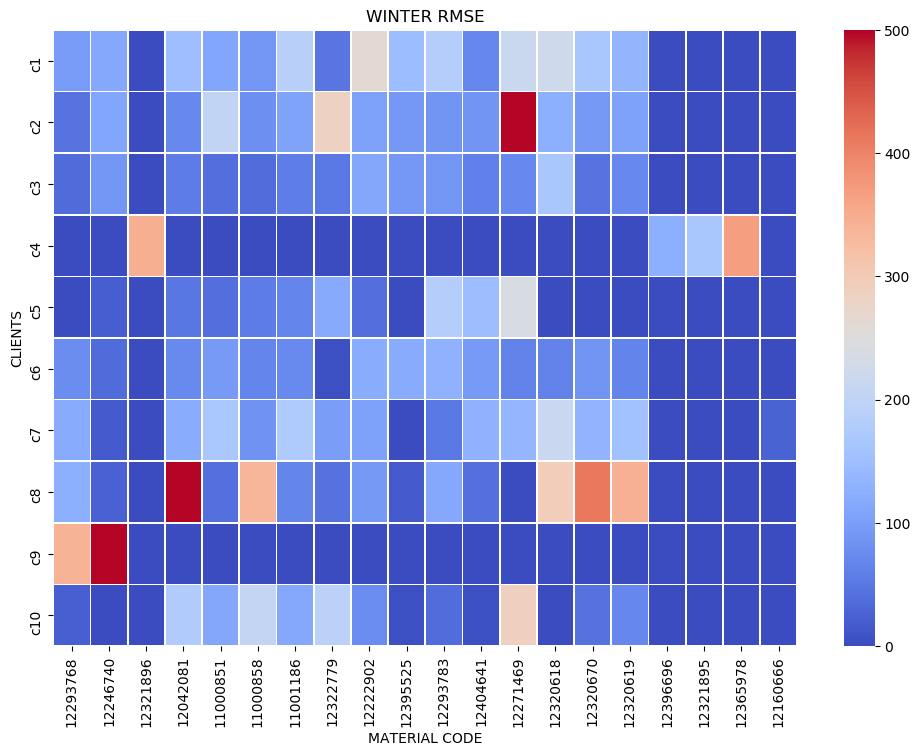

In [28]:
# PLOTTING HEAT MAP
plt.figure(figsize=(12,8))
ax = sns.heatmap(df_rmse1,vmin=0, vmax=500,cmap='coolwarm',linewidths=.5)
plt.title("WINTER RMSE")
plt.xlabel("MATERIAL CODE")
plt.ylabel("CLIENTS")
plt.show()

As it is show, most of pairs fall into low RMSE which would result in higher accuracy. However, there are some certain pairs such as C2 and material ID 12271469 which have a high error. However, based on number of data points in our time series, it would make sense to have high error in some of the pairs.

## FORCAST FOR A SINGLE VALUE OF CLIENT, MATERIAL AND DATE:
  For this we have to train the model on the whole data available.

  So we have the following function def winter_f which is similar to def winter except it trains the model on the whole data 


In [29]:
def winter_f (df,c,m):
  dff=df[df["Client"]==c]
  dff1=dff[dff["Material"]==m]
  
  # dropping duplicates
  dff2=dff1.index.drop_duplicates()
  dff2=dff1.loc[~dff1.index.duplicated(keep='first')]

  #Upsampling time
  dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
  r=pd.DataFrame(index=dte)
  r1=r.merge(dff2,left_index=True, right_index=True,how='outer')
  r1=r1.fillna(0)

  #Mapping dates
  dte1=np.arange(1,len(dte)+1,1)
  d={}
  d = dict(zip(dte, dte1))
  r1["date_en"]=r1.index.map(d)
  x=r1["Order Quantity"]

  #AUTO TRIPLE EXPONENTIAL SMOOTHING IMPLEMRNTATION
  model = ExponentialSmoothing(x, trend="add", damped=True, seasonal="add", seasonal_periods=7, dates=r1.index, freq=None, missing='none')
  model_fit = model.fit()

  return (r1,model_fit)

Now we manually enter the date client and material code to visualize the model forecast. This is done to compare the forcasting of different methods implemented in this project

**NOTE:** The following code doesn't work for special cases of non availablity of material or client code. These special cases are delt later 

In [30]:
# EXAMPLE
a='2020-03-10'
c="c8"
m=12293768

M= 12293768
C= c8
date= 2020-03-10


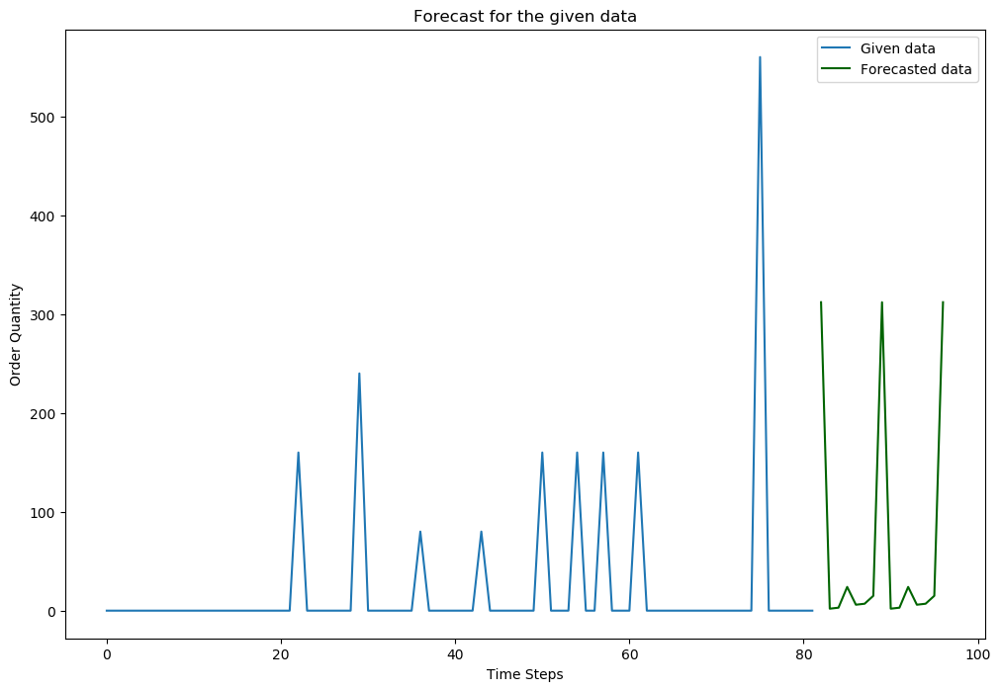

ORDER QUANTITY 312


In [31]:
#PLOTTING THE FORCAST DATA FOR A SINGLE VALUE OF M AND C
print("M=",m)
print("C=",c)
print("date=",a)

# CALCULATING FORCAST PERIOD FOR THE GIVEN DATE
dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
date1=pd.date_range(start="2019-12-05",end="2020-12-31")
date2=np.arange(1,len(date1)+1,1)
d1={}
d1 = dict(zip(date1, date2))
fc1=d1[pd.to_datetime(a)] 
fc1=fc1-len(dte)  
n_periods =int(fc1)

#FITTING THE MODEL
r1,model_fit=winter_f(df,c,m)
n_periods =int(fc1)

# Forecasting
fc = model_fit.forecast(n_periods)
index_of_fc = np.arange(len(r1["Order Quantity"]), len(r1["Order Quantity"])+n_periods)

#THE FORECAST CANNOT BE LESS THAN ZERO
fc1=[]
for i in fc:
  if i>0:
    fc1.append(int(i))
  elif i <=0:
    fc1.append(0)
fc=fc1

# make series for plotting purpose
fc_series = pd.Series(np.array(fc), index=index_of_fc)


# Plot
plt.figure(figsize=(12,8))
plt.plot(r1["Order Quantity"].values,label="Given data")
plt.plot(fc_series, color='darkgreen',label="Forecasted data")
plt.title("Forecast for the given data")

plt.xlabel("Time Steps")
plt.ylabel("Order Quantity")
plt.legend()

plt.show()

print("ORDER QUANTITY",int(fc[-1]))

The result based on the graph would order a quantity of 312. Having a high order quantity near the end of data has significantly impacted the prediction. There are two possibilities associated with the high demand near the end of the data set is that this amount of order quantity happens every so often, however since we only have 3 months of data points, we cannot for sure decide. The second possibility is that this number of order quantity happened due to an external situation that was not captured with 3 months of the data point. Either way, increasing the number of months would lead to higher accuracy, therefore error in our prediction is unavoidable.

## User input, Model, Predict:
In the following part, the code will accept user's inputs and after calculating the forecast, it will present it at the end. If the user wants to input all a,m and c variable, the method is straightforward. 

However, if the user wants to calculate the forecast for aggregated demand for certain client or certain material, he/she should **ENTER 0** for the client or material code not available. 

**NOTE:** Special cases of non availablity of material or client code is acceptable in the following set of code


**For example**, user wants to have calculate the demand for the date a='2020-03-10, for customer c='c10' for all the material, he/she should enter 0 as material (m=0). 

Similar to this approach use can calculate demand for specific material in specific date for all the customers by entering 0 as c (c=0)


In [32]:
#GET THE INPUT DATA MANUALLY
a = input("ENTER THE DATE AS STRING (FORMAT-'yyyy-mm-dd') ")
c = input("ENTER CLIENT CODE eg-'c5'") 
m = input("MATERIAL CODE ")



ENTER THE DATE AS STRING (FORMAT-'yyyy-mm-dd') 2020-03-15
ENTER CLIENT CODE eg-'c5'c1
MATERIAL CODE 0


In [33]:

# CONVERTING THE MATERIAL CODE TO INTEGER
m=int(m)

# CONVERTING THE GIVEN DATE TO A INTEGER VALUE WHICH REPRESENTS THE THE NO OF TIMESTEPS TO BE FORECASTED AHEAD
# THIS CODE WORKS FOR FORCATING DATES UPTO THE END OF 2020
date1=pd.date_range(start="2019-12-05",end="2020-12-31")
date2=np.arange(1,len(date1)+1,1)
d1={}
d1 = dict(zip(date1, date2))
fc1=d1[pd.to_datetime(a)] 
fc1=fc1-len(dte)  


# The following set of code is used to find the order quantity for the 
# given client and material code and also the aggregate quantity if one of the client and material data is not given
f_list=[]
if m == 0:
  for m1 in m_list:
    #model fit
    r1,model_fit=winter_f(df,c,m1)
    
    #model forecast
    n_periods =int(fc1)
    fc = model_fit.forecast(n_periods)
    f_list.append(fc[-1])

elif c=='0':
  for c1 in c_list:
    #Model fit
    r1,model_fit=winter_f(df,c1,m)
    
    #model forecast
    n_periods =int(fc1)
    fc = model_fit.forecast(n_periods)
    f_list.append(fc[-1])
else:
  #model fit
  r1,model_fit=winter_f(df,c,m)
  
  #model forecast
  n_periods =int(fc1)
  fc= model_fit.forecast(n_periods)
  f_list.append(fc[-1])


# Order quantity cannot be less than zero
f_list1=[]
for i in f_list:
  if i>0:
    f_list1.append(int(i))
  elif i <=0:
    f_list1.append(0)
f_list=f_list1

#Order Quantity
orderq=int(np.sum(f_list))
if orderq<=0:
  orderq=0

print("ORDER QUANTITY=",orderq)



ORDER QUANTITY= 196


## REFERENCES:
https://www.statsmodels.org/stable/generated/statsmodels.tsa.holtwinters.ExponentialSmoothing.html


https://machinelearningmastery.com/exponential-smoothing-for-time-series-forecasting-in-python/

https://machinelearningmastery.com/time-series-forecasting-methods-in-python-cheat-sheet/


https://towardsdatascience.com/time-series-in-python-exponential-smoothing-and-arima-processes-2c67f2a52788

# METHOD 2-LINEAR REGRESSION:
  Linear regression is a supervised machine learning algorithm. 
  
  We apply the linear regression algorithm for our time series problem by considering a fixed no of past order quantities as input and predicting the present order quantity.

  Here we chose past 9 values of order quantity as input and we use it to predict the present order quantity.
  The value 9 is choosen arbitarily and if needed we can include more values of past input.

 

**Liner Regression**

Linear regression evaluation is used to predict the value of a variable based totally on the value of every other variable. The variable you need to predict is known as the dependent variable. The variable you are using to predict another variable is called as independent variable.
This form of analysis estimates the coefficients of the linear equation, regarding one or extra impartial variables that excellently predict the value of the structured variable. Linear regression suits an immediately line or floor that minimizes the discrepancies between predicted and actual output values. There are simple linear regression calculators that use a “least squares” method to discover the first-rate-match line for a set of paired data. You then estimate the value of Y (independent variable) from X (dependent variable).

**Importance of Linear Regression**

Linear Regression is a long-established statistical procedure and due to this stature, the properties of linear regression models can be trained and understood quickly.
It provides an easy to interpret mathematical formula that can generate predictions and this area of application can be applied to various area in business and academic study.

**Linear Regression Assumptions**

•	The variables should be measured at a continuous level. Examples of continuous variables are time, order quantity, client names etc. 

•	Scatterplots can be used to measure the linear relationship between two variables.

•	The observations should be independent of each other (that is, there should be no dependency).

•	Data should not have significant outliers. 

•	A statistical concept in which the variances along the best-fit linear-regression line remain similar all through that line. This is called as homoscedasticity and one needs to check for it.

•	The residuals (errors) of the best-fit regression line follow normal distribution.


## MAJOR FUNCTIONS USED:
  We use the linear regression model from  SCIKIT LEARN library in python

  **from sklearn.linear_model import LinearRegression**

This linear regression function has few parameters but we are not going to fine tune them because they are not critical. We just pass the input data and let the other parameters be in default setting

  LinearRegression(data, fit_intercept=True, normalize=False, copy_X=True, n_jobs=None)


The following function extracts the data for the given client code and material code. Here we also have duplicate data, so we drop them.

Apart from this we form new columns w1 to w9 which represnts the input to be fed to the linear regression model.

With this dataframe as master we split the data into train and test set and we find the ROOT MEAN SQUARED ERROR for the test data.


This function returns the new modified data frame with inputs, the trained model and the rmse error

In [34]:
def lr(df,c,m):
  # Extracting client and material data
  dff=df[df["Client"]==c]
  dff1=dff[dff["Material"]==m]

  # dropping duplicates
  dff2=dff1.index.drop_duplicates()
  dff2=dff1.loc[~dff1.index.duplicated(keep='first')]

  #Upsampling time to have values for all dates
  dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
  r=pd.DataFrame(index=dte)
  r1=r.merge(dff2,left_index=True, right_index=True,how='outer')
  r1=r1.fillna(0)

  #Mapping dates
  dte1=np.arange(1,len(dte)+1,1)
  d={}
  d = dict(zip(dte, dte1))
  r1["date_en"]=r1.index.map(d)
  r1=r1.drop(["Client","Material","date_en"],axis=1)

  # Creating the input values for each order quantity
  w=9
  g=r1["Order Quantity"].values
  r2=r1
  r2=r2.iloc[w:]
  r2["w1"]=g[:-w]
  r2["w2"]=g[1:-(w-1)]
  r2["w3"]=g[2:-(w-2)]
  r2["w4"]=g[3:-(w-3)]
  r2["w5"]=g[4:-(w-4)]
  r2["w6"]=g[5:-(w-5)]
  r2["w7"]=g[6:-(w-6)]
  r2["w8"]=g[7:-(w-7)]
  r2["w9"]=g[8:-(w-8)]
  r2.head()

  # Seperating inputs and outputs
  x=r2.loc[:,"w1":"w9"]
  y=r2["Order Quantity"]

  #train test split
  xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.33,random_state=42)

  # Model fitting
  regr = LinearRegression()
  regr.fit(xtrain, ytrain)
  
  # Model prediction
  pred=regr.predict(xtest)
  # print(pred)
  
  #RMSE FOR TEST DATA
  rmse=np.sqrt(((pred - ytest) ** 2).mean())
  return (r2,regr,rmse)

## RMSE FOR MODEL:
  Before we move to the forcasting part lets find the model's performance for different material and client code.
  
  Since we have to predict a continuous data we cannot use accuracy(used for CATEGORICAL DATA)as performance metric.
  
  
  We will go with ROOT MEAN SQUARED ERROR to know the performance of the model across different client and material code.

In [35]:
c_list=['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10']
m_list=[12293768, 12246740, 12321896, 12042081, 11000851, 11000858,
       11001186, 12322779, 12222902, 12395525, 12293783, 12404641,
       12271469, 12320618, 12320670, 12320619, 12396696, 12321895,
       12365978, 12160666]

In [36]:
rmse_list2=[]

for c in c_list:
  for m in m_list:
    print("C,M",c,m)
    r2,regr,rmse=lr(df,c,m)
    rmse_list2.append(rmse)


print(rmse_list2)

C,M c1 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c1 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c2 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c3 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c4 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c5 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c6 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c7 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c8 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c9 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12293768


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12246740


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12321896


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12042081


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 11000851


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 11000858


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 11001186


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12322779


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12222902


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12395525


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12293783


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12404641


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12271469


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12320618


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12320670


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12320619


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12396696


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12321895


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12365978


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C,M c10 12160666


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

[52.098288006863, 57.980579827953036, 0.0, 182.82595747386915, 57.81737635858444, 94.10028413272788, 199.90542331742435, 52.797236457765834, 71.61408189159458, 106.48429817454162, 94.62398180492521, 38.26766870199535, 115.51694551173209, 76.58615981956501, 52.467895876387765, 65.82450743685327, 0.0, 0.0, 0.0, 0.0, 48.78284016759499, 67.26276728029588, 0.0, 55.8475105748457, 134.31161448219567, 72.85121961745429, 68.20783747302956, 175.24470810836775, 71.62930493799009, 98.22439050979001, 78.01725098972541, 59.845254666682074, 383.58206131660523, 44.50875622000685, 60.49253358609871, 95.0204804191942, 0.0, 0.0, 0.0, 0.0, 32.75310022087859, 56.00066810419569, 0.0, 55.79225532477517, 49.816187430974935, 82.23363622140941, 79.17515039314013, 63.56793694492309, 45.20261382920931, 135.48578587794177, 70.64980402430498, 101.47259585817739, 88.0680571864196, 61.93327328315449, 63.279522219688914, 58.55615079845564, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 392.31559912513177, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [37]:
#RMSE LIST TO ARRAY
rmse_array2=np.array(rmse_list2)
rmse_array2=np.reshape(rmse_array2,(len(c_list),len(m_list)))
#RMSE ARRAY TO DATAFRAME
df_rmse2=pd.DataFrame(rmse_array2,columns=m_list,index=c_list)
df_rmse2.tail()

,12293768,12246740,12321896,12042081,11000851,11000858,11001186,12322779,12222902,12395525,12293783,12404641,12271469,12320618,12320670,12320619,12396696,12321895,12365978,12160666
c6,32.705504,5.347891,0.0,34.090774,39.487791,35.750783,52.564304,21.000000,60.824631,69.171437,48.545893,44.679998,6.000000,115.817744,126.635451,195.928478,0.0,0.0,0.0,0.000000
c7,154.396935,1.444444,0.0,99.280341,117.360294,73.314367,94.495890,281.005787,74.387961,0.000000,57.349727,82.601114,511.935802,143.957633,143.092332,126.061376,0.0,0.0,0.0,5.346338
c8,47.832542,2.476190,0.0,417.107439,39.749665,402.494706,27.185082,3198.179668,49.697250,10.980668,36.574800,32.507177,0.000000,231.365905,352.159332,263.283684,0.0,0.0,0.0,0.000000
c9,2342.400000,3541.674094,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000
c10,54.684070,0.000000,0.0,216.143444,69.745791,206.572330,82.185584,131.556899,49.396978,30.664656,24.720270,10.648270,162.474377,0.000000,57.445218,58.802881,0.0,0.0,0.0,0.000000


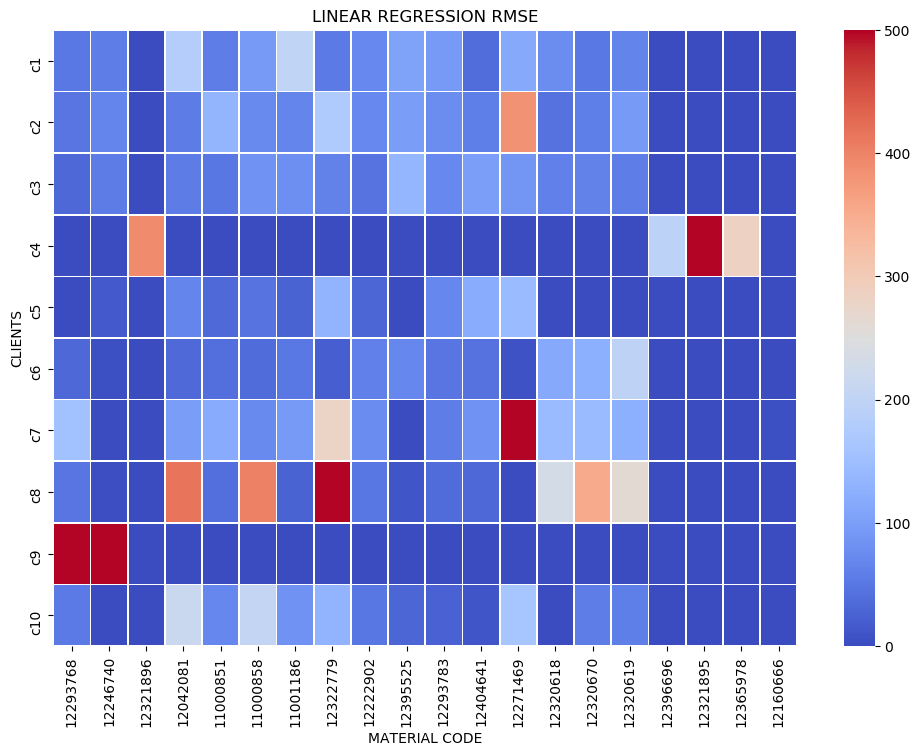

In [38]:
#HEATMAP
plt.figure(figsize=(12,8))
ax = sns.heatmap(df_rmse2,vmin=0, vmax=500,cmap='coolwarm',linewidths=.5)
plt.title("LINEAR REGRESSION RMSE")
plt.xlabel("MATERIAL CODE")
plt.ylabel("CLIENTS")
plt.show()

Compared to what we saw in the case of Winter's method, we have a more no of high error in linear regression. Client c4 for material 12365895 had a lower error in the case of Winter's method. However, we can see from the graph this error is significantly more in the case of linear regression.

 ## FORCAST FOR A SINGLE VALUE OF CLIENT, MATERIAL AND DATE:
  For this we have to train the model on the whole data available.

  So we have the following function def lr_f which is similar to def lr except it trains the model on the whole data 


In [39]:
def lr_f(df,c,m):
  # Extracting client and material data
  dff=df[df["Client"]==c]
  dff1=dff[dff["Material"]==m]

  # dropping duplicates
  dff2=dff1.index.drop_duplicates()
  dff2=dff1.loc[~dff1.index.duplicated(keep='first')]

  #Upsampling time to have values for all dates
  dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
  r=pd.DataFrame(index=dte)
  r1=r.merge(dff2,left_index=True, right_index=True,how='outer')
  r1=r1.fillna(0)

  #Mapping dates
  dte1=np.arange(1,len(dte)+1,1)
  d={}
  d = dict(zip(dte, dte1))
  r1["date_en"]=r1.index.map(d)
  r1=r1.drop(["Client","Material","date_en"],axis=1)

 # Creating the input values for each order quantity
  w=9
  g=r1["Order Quantity"].values
  r2=r1
  r2=r2.iloc[w:] 
  r2["w1"]=g[:-w]
  r2["w2"]=g[1:-(w-1)]
  r2["w3"]=g[2:-(w-2)]
  r2["w4"]=g[3:-(w-3)]
  r2["w5"]=g[4:-(w-4)]
  r2["w6"]=g[5:-(w-5)]
  r2["w7"]=g[6:-(w-6)]
  r2["w8"]=g[7:-(w-7)]
  r2["w9"]=g[8:-(w-8)]
  r2.head()

  # Sepreating input from output
  x=r2.loc[:,"w1":"w9"]
  y=r2["Order Quantity"]

  #Model fitting for the whole data available
  regr = LinearRegression()
  regr.fit(x, y)
  
  return (r2,regr)

Now we manually enter the date client and material code to visualize the model forecast. This is done to compare the forcasting of different methods implemented in this project

**NOTE:** The following code doesn't work for special cases of non availablity of material or client code. These special cases are delt later 

In [40]:
# EXAMPLE
a='2020-03-10'
c="c8"
m=12293768

  To do time series prediction in Linear regression we do the following
- Convert the given date to integer (in terms of no of time steps to be predicted(N)) 
- predict the output with the last 9 order quantities to get the 1st predicted value(1st time step)
- Now with the last 8 order quantities and the 1st predicted value calculate the 2nd prediction
- Repeat the above two steps till the required time step N is reached

The following code block does the steps explained above

In [41]:
#CONVERT THE GIVEN DATE TIME TO INTEGER VALUE(NO OF TIME STEPS TO BE PREDICTED )
dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
date1=pd.date_range(start="2019-12-05",end="2020-12-31")
date2=np.arange(1,len(date1)+1,1)
d1={}
d1 = dict(zip(date1, date2))
fc1=d1[pd.to_datetime(a)] 
f=fc1-len(dte) # NO OF TIME STEPS TO BE PREDICTED

#CALLING THE lr_f FUNCTION TO TRAIN THE MODEL FOR THE GIVEN CLIENT AND MATERIAL CODE
r2,regr_fit=lr_f (df,c,m)

#EXTRACTING INPUTS AND OUTPUTS FROM THE DATA FRAME
y=r2["Order Quantity"].values
x=r2.loc[:,"w1":"w9"]

# NOW WE PREDICT F TIMES INTO THE FUTURE
for i in range(0,f):
  #extracting last 9 order quantity and setting them as input
  dt= pd.DataFrame((y[-9:]).reshape(1,9), columns=['w1',"w2","w3","w4","w5","w6","w7","w8","w9"])
  x1=x.append(dt,ignore_index=True)

  #Predicting the Order quantity
  pred=regr_fit.predict(x1.iloc[-1,:].values.reshape(1, -1))
  pred=int(pred)

  #Prediction cannot be less than zero
  if pred>0:
    pred=pred
  elif pred <=0:
    pred=0
  
  # Appending the new prediction to the list of order quantities
  y=list(y)
  y.append(pred)
  y=np.array(y)

print("Order Quantity=",y[-1])

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

Order Quantity= 111.0


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



Now we visulize the forecast by plotting it

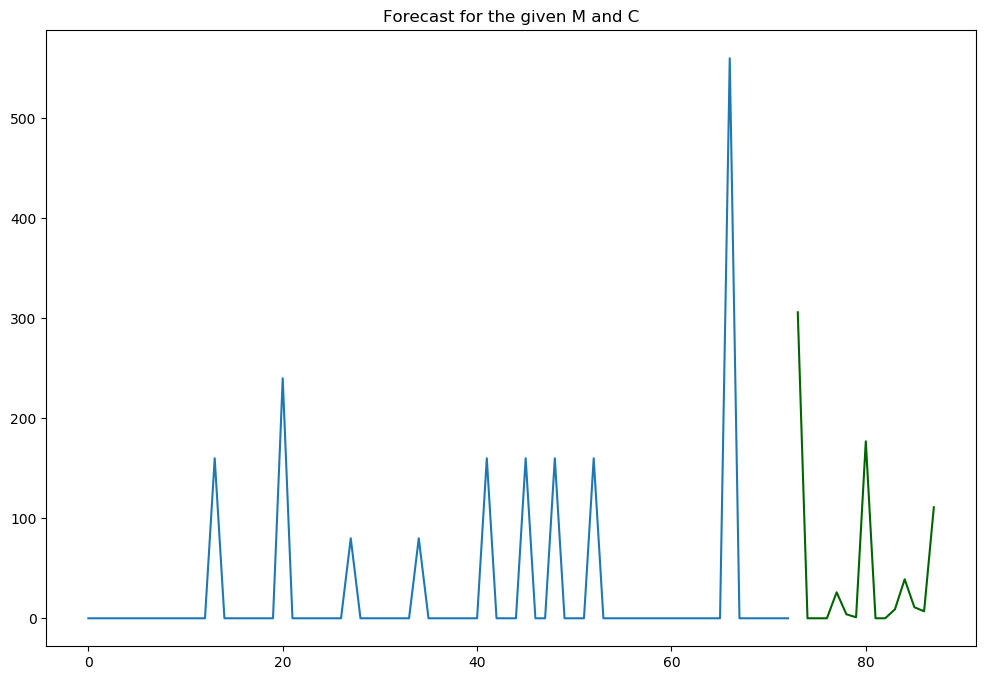

Order quantity for the given date(LAST TIME STEP)= 111.0


In [42]:
#No of time steps forecasted
n_periods =f

#Extracting forcasted data
fc=y[-f:]

#Adding index to forecast
index_of_fc = np.arange(len(r2["Order Quantity"]), len(r2["Order Quantity"])+n_periods)

# make series for plotting purpose
fc_series = pd.Series(fc, index=index_of_fc)

# Plot
plt.figure(figsize=(12,8))
plt.plot(r2["Order Quantity"].values)
plt.plot(fc_series, color='darkgreen')
plt.title("Forecast for the given M and C")
plt.show()

print("Order quantity for the given date(LAST TIME STEP)=",fc[-1])

The result shows 108 order quantity for the given date, material and client. However, this value was around 300. Based on the RMSE we can say linear regression has more accuracy than Winter's method. 

## User input, Model, Predict
In the following part, the code will accept user's inputs and after calculating the forecast, it will present it at the end. If the user wants to input all a,m and c variable, the method is straightforward. 

However, if the user wants to calculate the forecast for aggregated demand for certain product or certain material,he/she should **ENTER 0** for the client or material code not available. 

**NOTE:** Special cases of non availablity of material or client code is acceptable in the following set of code

**For example**, user wants to have calculate the demand for the date a='2020-03-10, for customer c='c10' for all the material, he/she should enter 0 as material (m=0). 

Similar to this approach use can calculate demand for specific material in specific date for all the customers by entering 0 as c (c=0)


In [43]:
#GET THE INPUT DATA 
a = input("ENTER THE DATE AS STRING (FORMAT-'yyyy-mm-dd') ")
c = input("ENTER CLIENT CODE AS STRING eg-'c5'") 
m = input("MATERIAL CODE ")

ENTER THE DATE AS STRING (FORMAT-'yyyy-mm-dd') 2020-03-15
ENTER CLIENT CODE AS STRING eg-'c5'c1
MATERIAL CODE 0


In [44]:
# Converting material code from string to integer
m=int(m)


#CONVERT THE GIVEN DATE TIME TO INTEGER VALUE(NO OF TIME STEPS TO BE PREDICTED )
dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
date1=pd.date_range(start="2019-12-05",end="2020-12-31")
date2=np.arange(1,len(date1)+1,1)
d1={}
d1 = dict(zip(date1, date2))
fc1=d1[pd.to_datetime(a)] 
fc1=fc1-len(dte)  # TO FEED TO FORCAST


#list of order quantities for different client and material for the given special case
f_list=[]

# If material code is zero iterate through all the nmaterial for the given client and find the list of order quantities
if m == 0:
  for m1 in m_list:
    # Model training
    r2,regr_fit=lr_f(df,c,m1)
    
    #Time steps to be forecasted
    f =int(fc1)
    
    # getting input and output
    y=r2["Order Quantity"].values
    x=r2.loc[:,"w1":"w9"]

    #Forecasting N time steps ahead
    for i in range(0,f):
      #extracting last 9 order quantity and setting them as input
      dt= pd.DataFrame((y[-9:]).reshape(1,9), columns=['w1',"w2","w3","w4","w5","w6","w7","w8","w9"])
      x1=x.append(dt,ignore_index=True)

      #Predicting the Order quantity
      pred=regr_fit.predict(x1.iloc[-1,:].values.reshape(1, -1))
      pred=int(pred)

      #Prediction cannot be less than zero
      if pred>0:
        pred=pred
      elif pred <=0:
        pred=0
      
      # Appending the new prediction to the list of order quantities
      y=list(y)
      y.append(pred)
      y=np.array(y)
    
    #List of order quantities for different materials
    f_list.append(y[-1])

#If client code is zero iterate through all the clients for the given material and find the list of order quantities
elif c=='0':
  for c1 in c_list:
    # Model training
    r2,regr_fit=lr_f(df,c1,m)

    #Time steps to be forecasted
    f =int(fc1)

    # getting input and output
    y=r2["Order Quantity"].values
    x=r2.loc[:,"w1":"w9"]

    #Forecasting N time steps ahead
    for i in range(0,f):
      #extracting last 9 order quantity and setting them as input
      dt= pd.DataFrame((y[-9:]).reshape(1,9), columns=['w1',"w2","w3","w4","w5","w6","w7","w8","w9"])
      x1=x.append(dt,ignore_index=True)

      #Predicting the Order quantity
      pred=regr_fit.predict(x1.iloc[-1,:].values.reshape(1, -1))
      pred=int(pred)

      #Prediction cannot be less than zero
      if pred>0:
        pred=pred
      elif pred <=0:
        pred=0

      # Appending the new prediction to the list of order quantities
      y=list(y)
      y.append(pred)
      y=np.array(y)

    #List of order quantities for different clients
    f_list.append(y[-1])

# If both client code and material code is given
else:
  # Model training
  r2,regr_fit=lr_f(df,c,m)
  #Time steps to be forecasted
  f =int(fc1)

  # getting input and output
  y=r2["Order Quantity"].values
  x=r2.loc[:,"w1":"w9"]

  #Forecasting N time steps ahead
  for i in range(0,f):
    #extracting last 9 order quantity and setting them as input
    dt= pd.DataFrame((y[-9:]).reshape(1,9), columns=['w1',"w2","w3","w4","w5","w6","w7","w8","w9"])
    x1=x.append(dt,ignore_index=True)

    #Predicting the Order quantity
    pred=regr_fit.predict(x1.iloc[-1,:].values.reshape(1, -1))
    pred=int(pred)

    #Prediction cannot be less than zero
    if pred>0:
      pred=pred
    elif pred <=0:
      pred=0

    # Appending the new prediction to the list of order quantities
    y=list(y)
    y.append(pred)
    y=np.array(y)

  #Order Quantity for the given client and material code
  f_list.append(y[-1])

#Order quantity cannot be less than zero
f_list1=[]
for i in f_list:
  if i>0:
    f_list1.append(int(i))
  elif i <=0:
    f_list1.append(0)
f_list=f_list1

#Total order Quantity
orderq=int(np.sum(f_list))
if orderq<=0:
  orderq=0
print("ORDER QUANTITY=",orderq)



C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

ORDER QUANTITY= 657


C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\aditya\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [45]:
print("ORDER QUANTITY=",orderq)

ORDER QUANTITY= 657


# METHOD 3- ARIMA:



**ARIMA Model for Time Series Forecasting**

ARIMA is a widely used statistical method for time series forecasting. It is used when the Time Series values are related or correlated with their immediate previous values. In simple words ARIMA can used to forecast non-stationary time series. 

ARIMA is an acronym that stands for ***AutoRegressive Integrated Moving Average*** and is a generalization of the simpler AutoRegressive Moving Average and adds the notion of integration to it. To briefly talk about the key aspects of the model;

	AR – Autoregression: A model that uses the dependent relationship between an observation and some number of lagged observations. 
	I – Integrated: The use of differencing of raw observations (i.e., subtracting an observation from an observation at the previous time step) in order to make the time series stationary. 
	MA – Moving Average: A model that uses the dependency between an observation and a residual error from a moving average model applied to lagged observations.

It is obvious that each of the above-mentioned components are used as a parameter in the model. The generic notation of ARIMA(p,d,q) where p, d, q are integer values which quickly specified the ARIMA model being used. 
The parameters of the ARIMA model are defined as follows: 

	p: It is the number of lag observations included in the model, also called as the lag order. This can be obtained from the partial-correlation function. 
	d: It is the number of times that the raw observations are differences, also called as the degree of differencing. This can be obtained after series of trial and error on the model and validating the results. 
	q: It is the size of the moving average window, also called the order of moving average. This can be obtained from auto-correlation function. 

**Non – Seasonal ARIMA Models**

In an autoregression model, the variable of interest is forecasted using a linear combination of past values of the variable. An autoregressive model of order p can be written as,

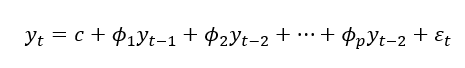

Where ε_t is white noise. This is like a multiple regression but with lagged values of y_t as predictors. This is simply referred to as an AR(p) model.

	In a moving average model, the variable of interest is forecasted using past forecast errors in a regression-like model. A moving average model of order q can be written as,

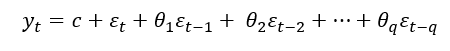

This is simply referred to as a MA(q) model. It is also important to note that each value of y_t can be thought of as a weighted moving average of the past few forecast errors. 

	Now, if we combine differencing with autoregression and a moving average model, we obtain a non-seasonal ARIMA model. The full model can be written as, 

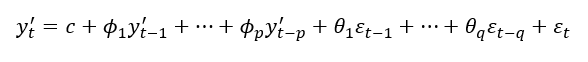

Where y_t^' is the differenced series (it may have been differenced more than once). We can call this an ARIMA(p,d,q) model. 

**Seasonal ARIMA Models**

If the time series as seasonal factors or a trend, it can be included in the ARIMA model. It is formed by including additional seasonal terms in the ARIMA model and can be represented as follows,

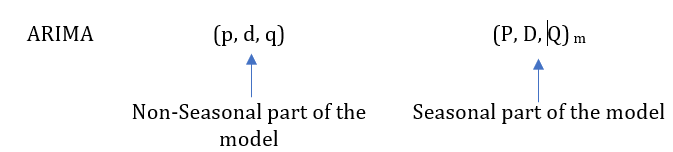

Where m is the number of observations per year.  The seasonal part of the model consists of terms that are like the non-seasonal components of the model.

**Modelling Procedure**

When fitting an ARIMA model to a set of (non – seasonal) time series data, the following procedure provides useful general approach,

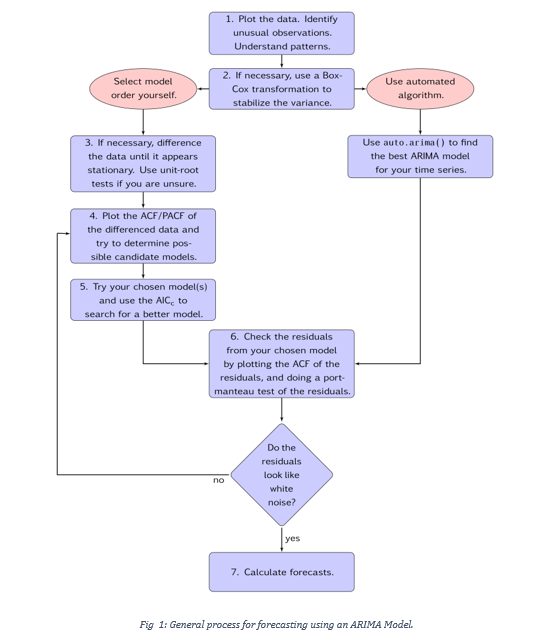


## MAJOR FUNCTIONS USED:
  We use the auto_arima function from the pmdarima library in python. This function automatically finds the best ARIMA fit for our data.
   
**import pmdarima as pm**

It has a lot of parameters as shown below

auto_arima(y, exogenous=None, start_p=2, d=None, start_q=2, max_p=5, max_d=2, max_q=5, start_P=1, D=None, start_Q=1, max_P=2, max_D=1, max_Q=2, max_order=10, m=1, seasonal=True, stationary=False, information_criterion='aic', alpha=0.05, test='kpss', seasonal_test='ch', stepwise=True, n_jobs=1, start_params=None, trend='c', method=None, transparams=True, solver='lbfgs', maxiter=50, disp=0, callback=None, offset_test_args=None, seasonal_test_args=None, suppress_warnings=False, error_action='warn', trace=False, random=False, random_state=None, n_fits=10, return_valid_fits=False, out_of_sample_size=0, scoring='mse', scoring_args=None, **fit_args)

At first look it seems intimidating but we need to focus on only few parameters to make the function work:

The parametrs p,q,d,P,Q,D and m are to be understood to initialize the auto arima function


p- auto regression term(LAG term)


q-Moving average term


d-Integration term(differencing term)



Similarly PQD are same as p,q,d but for seasonality

 For p and q values we can set the minimum and maximum range and the function iterates through all of them to find the best fit based on one of the following criteria
 - Akaike Information Criterion(Default)
 - Corrected Akaike Information Criterion,
 - Bayesian Information Criterion,
 - Hannan-Quinn Information Criterion


  For d the funtion automatically finda the best d based on different tests which are available. For our case we are going with "Augmented Dickey-Fuller" test to find optimal d

  Apart from this the function can also fit seasonal data. We have to set Seasonal parameter as "True". If this parameter is enabled we have to set values for P,Q and D which corresponds to seasonality

  We can let the function decide the optimal values of P and Q by just specifying the min and max values for these parameters 

  Apart from this we have to set the parameter m which corresponds to frequency. Since it is a daily data we set it as 7

Our PMD AUTO ARIMA MODEL IS SHOWN BELOW

**pm.auto_arima**(train, start_p=1, start_q=1,test='adf',
                      max_p=10, max_q=10,max_d=10,                     m=7,     d=None,               seasonal=True,                      start_P=1, 
                      D=1, 
                      trace=True,
                      error_action='ignore',                   suppress_warnings=True, 
                      stepwise=True)


In [46]:
def arima(df,c,m):
  #Extracting Client and material data
  dff=df[df["Client"]==c]
  dff1=dff[dff["Material"]==m]
  
  # dropping duplicates
  dff2=dff1.index.drop_duplicates()
  dff2=dff1.loc[~dff1.index.duplicated(keep='first')]
  # dff2.head(20)

  #Upsampling time
  dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
  r=pd.DataFrame(index=dte)
  r1=r.merge(dff2,left_index=True, right_index=True,how='outer')
  r1=r1.fillna(0)
  # r1.tail(20)

  #Mapping dates
  dte1=np.arange(1,len(dte)+1,1)
  d={}
  d = dict(zip(dte, dte1))
  r1["date_en"]=r1.index.map(d)

  # Order quantity
  x=r1["Order Quantity"]

  #Splitting the data into train and test data
  train, test = train_test_split_arima(x, train_size=0.70)

  #AUTO ARIMA IMPLEMRNTATION
  model = pm.auto_arima(train, start_p=1, start_q=1,
                      test='adf',       # use adftest to find optimal 'd'
                      max_p=10, max_q=10,max_d=10, # maximum p and q
                      m=7,              # frequency of series
                      d=None,           # let model determine 'd'
                      seasonal=True,    # Seasonality
                      start_P=1, 
                      D=1, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                      stepwise=True)

  #Forecasting
  forecasts = model.predict(test.shape[0])  # predict N steps into the future
  
  # ROOT MEAN SQUARED ERROR
  rmse = np.mean((forecasts - test)**2)**.5
  print("rmse",rmse)

  return (r1,model,rmse)

## RMSE FOR MODEL:
  Before we move to the forcasting part lets find the model's performance for different material and client code.
  
  Since we have to predict a continuous data we cannot use accuracy(used for CATEGORICAL DATA)as performance metric.
  
  
  We will go with ROOT MEAN SQUARED ERROR to know the performance of the model across different client and material code.

In [47]:
# MAster list of CLient and Material data
c_list=['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10']
m_list=[12293768, 12246740, 12321896, 12042081, 11000851, 11000858,
       11001186, 12322779, 12222902, 12395525, 12293783, 12404641,
       12271469, 12320618, 12320670, 12320619, 12396696, 12321895,
       12365978, 12160666]

**NOTE: The following code block takes much long time to execute**

In [48]:
#Calculating RMSE for all client and material code
rmse_list=[]
for c in c_list:
  for m in m_list:
    print("C,M",c,m)
    if c=='c7' and m==12246740:
      rmse=4000
      rmse_list.append(rmse)
      continue
    r3,_,rmse=arima(df,c,m)
    rmse_list.append(rmse)

print(rmse_list)

C,M c1 12293768
Performing stepwise search to minimize aic
Fit ARIMA(1,1,1)x(1,1,1,7) [intercept=True]; AIC=465.059, BIC=476.409, Time=1.081 seconds
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=True]; AIC=506.885, BIC=510.669, Time=0.010 seconds
Fit ARIMA(1,1,0)x(1,1,0,7) [intercept=True]; AIC=473.868, BIC=481.436, Time=0.137 seconds
Fit ARIMA(0,1,1)x(0,1,1,7) [intercept=True]; AIC=462.228, BIC=469.795, Time=0.285 seconds
Near non-invertible roots for order (0, 1, 1)(0, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=False]; AIC=504.885, BIC=506.777, Time=0.009 seconds
Fit ARIMA(1,1,1)x(0,1,1,7) [intercept=True]; AIC=463.489, BIC=472.948, Time=0.178 seconds
Fit ARIMA(1,1,1)x(0,1,0,7) [intercept=True]; AIC=473.529, BIC=481.097, Time=0.103 seconds
Fit ARIMA(1,1,1)x(0,1,2,7) [intercept=True]; AIC=465.171, BIC=476.522, Time=0.502 seconds
Fit ARIMA(1,1,1)x(1,1,0,7) [intercept=True]; AIC=467.449, BIC=

Fit ARIMA(1,1,2)x(1,1,1,7) [intercept=True]; AIC=656.740, BIC=669.983, Time=0.559 seconds
Near non-invertible roots for order (1, 1, 2)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(0,1,0)x(1,1,1,7) [intercept=True]; AIC=672.475, BIC=680.042, Time=0.361 seconds
Near non-invertible roots for order (0, 1, 0)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(0,1,2)x(1,1,1,7) [intercept=True]; AIC=655.802, BIC=667.153, Time=0.607 seconds
Near non-invertible roots for order (0, 1, 2)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(2,1,0)x(1,1,1,7) [intercept=True]; AIC=664.694, BIC=676.045, Time=0.546 seconds
Fit ARIMA(2,1,2)x(1,1,1,7) [intercept=True]; AIC=657.944, BIC=673.079, Time=0.644 seconds
Near non-invertible roots for order (2, 1, 2)(1, 1, 1, 7); setting score to 

Fit ARIMA(1,1,0)x(1,1,1,7) [intercept=True]; AIC=592.317, BIC=601.776, Time=0.373 seconds
Fit ARIMA(2,1,1)x(1,1,1,7) [intercept=True]; AIC=589.762, BIC=603.005, Time=0.895 seconds
Near non-invertible roots for order (2, 1, 1)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,2)x(1,1,1,7) [intercept=True]; AIC=584.082, BIC=597.325, Time=0.469 seconds
Near non-invertible roots for order (1, 1, 2)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(0,1,0)x(1,1,1,7) [intercept=True]; AIC=600.421, BIC=607.988, Time=0.288 seconds
Fit ARIMA(0,1,2)x(1,1,1,7) [intercept=True]; AIC=587.793, BIC=599.144, Time=0.875 seconds
Near non-invertible roots for order (0, 1, 2)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(2,1,0)x(1,1,1,7) [intercept=True]; AIC=593.324, BIC=604.675, Time=

Fit ARIMA(1,1,1)x(0,1,0,7) [intercept=True]; AIC=561.886, BIC=569.453, Time=0.276 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 0, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(0,1,2)x(0,1,0,7) [intercept=True]; AIC=562.318, BIC=569.885, Time=0.151 seconds
Fit ARIMA(1,1,0)x(0,1,0,7) [intercept=True]; AIC=571.744, BIC=577.420, Time=0.040 seconds
Fit ARIMA(1,1,2)x(0,1,0,7) [intercept=True]; AIC=564.035, BIC=573.494, Time=0.174 seconds
Total fit time: 1.853 seconds
rmse 261.43987108246205
C,M c1 12395525
Performing stepwise search to minimize aic
Fit ARIMA(1,1,1)x(1,1,1,7) [intercept=True]; AIC=603.972, BIC=615.323, Time=0.315 seconds
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=True]; AIC=639.088, BIC=642.872, Time=0.016 seconds
Fit ARIMA(1,1,0)x(1,1,0,7) [intercept=True]; AIC=618.376, BIC=625.943, Time=0.110 seconds
Fit ARIMA(0,1,1)x(0,1,1,7) [intercept=True]; AIC=600.392, BIC=607.959, Time=0.174 seconds
Near non-

Fit ARIMA(1,1,1)x(2,1,0,7) [intercept=True]; AIC=517.334, BIC=528.685, Time=0.778 seconds
Near non-invertible roots for order (1, 1, 1)(2, 1, 0, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,1)x(2,1,2,7) [intercept=True]; AIC=515.900, BIC=531.035, Time=1.097 seconds
Near non-invertible roots for order (1, 1, 1)(2, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.991)
Fit ARIMA(0,1,1)x(1,1,1,7) [intercept=True]; AIC=520.971, BIC=530.430, Time=0.614 seconds
Near non-invertible roots for order (0, 1, 1)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,0)x(1,1,1,7) [intercept=True]; AIC=540.946, BIC=550.405, Time=0.226 seconds
Fit ARIMA(2,1,1)x(1,1,1,7) [intercept=True]; AIC=523.612, BIC=536.855, Time=0.568 seconds
Near non-invertible roots for order (2, 1, 1)(1, 1, 1, 7); setting score to 

Fit ARIMA(1,1,1)x(2,1,2,7) [intercept=True]; AIC=541.720, BIC=556.855, Time=1.225 seconds
Near non-invertible roots for order (1, 1, 1)(2, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.995)
Fit ARIMA(0,1,1)x(1,1,1,7) [intercept=True]; AIC=542.407, BIC=551.867, Time=0.207 seconds
Near non-invertible roots for order (0, 1, 1)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.998)
Fit ARIMA(1,1,0)x(1,1,1,7) [intercept=True]; AIC=553.722, BIC=563.181, Time=0.224 seconds
Fit ARIMA(2,1,1)x(1,1,1,7) [intercept=True]; AIC=545.295, BIC=558.537, Time=0.332 seconds
Near non-invertible roots for order (2, 1, 1)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.998)
Fit ARIMA(1,1,2)x(1,1,1,7) [intercept=True]; AIC=546.320, BIC=559.562, Time=0.780 seconds
Near non-invertible roots for order (1, 1, 2)(1, 1, 1, 7); setting score to 

Fit ARIMA(1,1,1)x(2,1,2,7) [intercept=True]; AIC=513.145, BIC=528.279, Time=1.245 seconds
Near non-invertible roots for order (1, 1, 1)(2, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIMA(0,1,1)x(1,1,1,7) [intercept=True]; AIC=512.381, BIC=521.841, Time=0.426 seconds
Near non-invertible roots for order (0, 1, 1)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIMA(1,1,0)x(1,1,1,7) [intercept=True]; AIC=521.467, BIC=530.926, Time=0.273 seconds
Fit ARIMA(2,1,1)x(1,1,1,7) [intercept=True]; AIC=514.580, BIC=527.823, Time=0.364 seconds
Near non-invertible roots for order (2, 1, 1)(1, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.994)
Fit ARIMA(1,1,2)x(1,1,1,7) [intercept=True]; AIC=515.839, BIC=529.082, Time=0.652 seconds
Fit ARIMA(0,1,0)x(1,1,1,7) [intercept=True]; AIC=542.035, BIC=549.602, Time=

KeyboardInterrupt: 

In [ ]:
# ERROR LIST TO ARRAY
rmse_array=np.array(rmse_list)
rmse_array=np.reshape(rmse_array,(len(c_list),len(m_list)))
#ARRAY TO DATAFRAME
df_rmse=pd.DataFrame(rmse_array,columns=m_list,index=c_list)
df_rmse.head(10)

In [ ]:
#HEAT MAP OF ERRORS
plt.figure(figsize=(12,8))
ax = sns.heatmap(df_rmse,vmin=0, vmax=500,cmap='coolwarm',linewidths=.5)
plt.title("ARIMA RMSE")
plt.xlabel("MATERIAL CODE")
plt.ylabel("CLIENTS")
plt.show()

Results from the table and graph show the ARIMA has more errors in some cases and lower error in others. However, it has better accuracy in some cases. 

## FORCAST FOR A SINGLE VALUE OF CLIENT, MATERIAL AND DATE:
 For this we have to train the model on the whole data available.

  So we have the following function def arima_f which is similar to def arima except it trains the model on the whole data 


In [49]:
def arima_f(df,c,m):
  #Extracting data for given client and material code
  dff=df[df["Client"]==c]
  dff1=dff[dff["Material"]==m]
  
  # dropping duplicates
  dff2=dff1.index.drop_duplicates()
  dff2=dff1.loc[~dff1.index.duplicated(keep='first')]

  #Upsampling time
  dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
  r=pd.DataFrame(index=dte)
  r1=r.merge(dff2,left_index=True, right_index=True,how='outer')
  r1=r1.fillna(0)

  #Mapping dates
  dte1=np.arange(1,len(dte)+1,1)
  d={}
  d = dict(zip(dte, dte1))
  r1["date_en"]=r1.index.map(d)
 
  #Extracting Input
  x=r1["Order Quantity"]

  #AUTO ARIMA IMPLEMRNTATION
  model = pm.auto_arima(x, start_p=1, start_q=1,
                      test='adf',       # use adftest to find optimal 'd'
                      max_p=10, max_q=10,max_d=10, # maximum p and q
                      m=7,              # frequency of series
                      d=None,           # let model determine 'd'
                      seasonal=True,    # Seasonality
                      start_P=1, 
                      D=1, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                      stepwise=True)

  return (r1,model)

Now we manually enter the date client and material code to visualize the model forecast. This is done to compare the forcasting of different methods implemented in this project

**NOTE:** The following code doesn't work for special cases of non availablity of material or client code. These special cases are delt later 

In [50]:
a='2020-03-10'
c="c8"
m=12293768

M= 12293768
C= c8
date= 2020-03-10
Performing stepwise search to minimize aic
Fit ARIMA(1,1,1)x(1,1,1,7) [intercept=True]; AIC=861.033, BIC=874.857, Time=0.300 seconds
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=True]; AIC=910.773, BIC=915.381, Time=0.012 seconds
Fit ARIMA(1,1,0)x(1,1,0,7) [intercept=True]; AIC=886.295, BIC=895.511, Time=0.125 seconds
Fit ARIMA(0,1,1)x(0,1,1,7) [intercept=True]; AIC=857.833, BIC=867.049, Time=0.160 seconds
Near non-invertible roots for order (0, 1, 1)(0, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=False]; AIC=908.773, BIC=911.077, Time=0.010 seconds
Fit ARIMA(1,1,1)x(0,1,1,7) [intercept=True]; AIC=859.832, BIC=871.352, Time=0.190 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,1)x(1,1,0,7) [intercept=True]; AIC=862.102, BIC=873

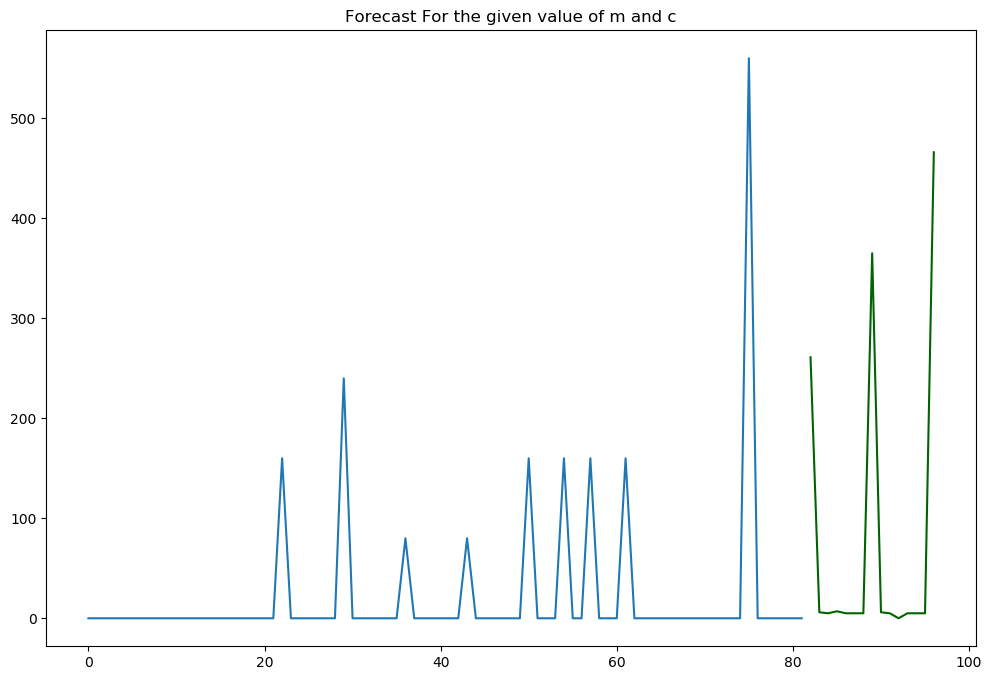

ORDER QUANTITY= 466


In [51]:
#PLOTTING THE FORCAST DATA FOR A SINGLE VALUE OF M AND C
print("M=",m)
print("C=",c)
print("date=",a)

# CALCULATING FORCAST PERIOD FOR THE GIVEN DATE
dte=pd.date_range(start="2019-12-05",end="2020-02-24 ")
date1=pd.date_range(start="2019-12-05",end="2020-12-31")
date2=np.arange(1,len(date1)+1,1)
d1={}
d1 = dict(zip(date1, date2))
fc1=d1[pd.to_datetime(a)] 
fc1=fc1-len(dte)  
n_periods =int(fc1)

#FITTING THE MODEL
r3,model=arima_f(df,c,m)

#Forecasting
n_periods =int(fc1)
fc, confint = model.predict(n_periods=n_periods, return_conf_int=True)
index_of_fc = np.arange(len(r3["Order Quantity"]), len(r3["Order Quantity"])+n_periods)

#FORECAST CANNOT BE LESS THAN ZERO
fc2=[]
for i in fc:
  if i>0:
    fc2.append(int(i))
  elif i <=0:
    fc2.append(0)
fc=fc2


# make series for plotting purpose
fc_series = pd.Series(fc, index=index_of_fc)

# Plot
plt.figure(figsize=(12,8))
plt.plot(r3["Order Quantity"].values)
plt.plot(fc_series, color='darkgreen')
plt.title("Forecast For the given value of m and c")
plt.show()

print("ORDER QUANTITY=", fc[-1])

## User input, Model, Predict
In the following part, the code will accept user's inputs and after calculating the forecast, it will present it at the end. If the user wants to input all a,m and c variable, the method is straightforward. 

However, if the user wants to calculate the forecast for aggregated demand for certain product or certain material, he/she should **ENTER 0** for the client or material code not available. 

**For example**, user wants to have calculate the demand for the date a='2020-03-10, for customer c='c10' for all the material, he/she should enter 0 as material (m=0). 

Similar to this approach use can calculate demand for specific material in specific date for all the customers by entering 0 as c (c=0)


In [52]:
#GET THE INPUT DATA 
a = input("ENTER THE DATE AS STRING (FORMAT-'yyyy-mm-dd') ")
c = input("ENTER CLIENT CODE AS STRING eg-'c5'") 
m = input("MATERIAL CODE ")

ENTER THE DATE AS STRING (FORMAT-'yyyy-mm-dd') 2020-03-15
ENTER CLIENT CODE AS STRING eg-'c5'c1
MATERIAL CODE 0


In [53]:
# Converting material code from string to integer
m=int(m)

#CONVERT THE GIVEN DATE TIME TO INTEGER VALUE(NO OF TIME STEPS TO BE PREDICTED )
date1=pd.date_range(start="2019-12-05",end="2020-12-31")
date2=np.arange(1,len(date1)+1,1)
d1={}
d1 = dict(zip(date1, date2))
fc1=d1[pd.to_datetime(a)] 
fc1=fc1-len(dte)  # No o time steps to be forecasted

#list of order quantities for different client and material for the given special case
f_list=[]
if m == 0:
  for m1 in m_list:
    #Model fit
    r3,model=arima_f(df,c,m1)
    #Model forecasting
    n_periods =int(fc1)
    fc, confint = model.predict(n_periods=n_periods, return_conf_int=True)
    f_list.append(fc[-1])
elif c=='0':
  for c1 in c_list:
    #Model fit
    r3,model=arima_f(df,c1,m)
    #Model forecasting
    n_periods =int(fc1)
    fc, confint = model.predict(n_periods=n_periods, return_conf_int=True)
    f_list.append(fc[-1])
else:
  #Model forecasting
  r3,model=arima_f(df,c,m)
  #Model forecasting
  n_periods =int(fc1)
  fc, confint = model.predict(n_periods=n_periods, return_conf_int=True)
  f_list.append(fc[-1])

#Prediction cannot be less than zero
f_list1=[]
for i in f_list:
  if i>0:
    f_list1.append(int(i))
  elif i <=0:
    f_list1.append(0)
f_list=f_list1

# FINAL ORDER QUANTITY
orderq=int(np.sum(f_list))
if orderq<=0:
  orderq=0

print("ORDER QUANTITY=",orderq)



Performing stepwise search to minimize aic
Fit ARIMA(1,1,1)x(1,1,1,7) [intercept=True]; AIC=772.870, BIC=786.695, Time=0.331 seconds
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=True]; AIC=829.639, BIC=834.247, Time=0.012 seconds
Fit ARIMA(1,1,0)x(1,1,0,7) [intercept=True]; AIC=792.603, BIC=801.819, Time=0.150 seconds
Fit ARIMA(0,1,1)x(0,1,1,7) [intercept=True]; AIC=769.389, BIC=778.605, Time=0.318 seconds
Near non-invertible roots for order (0, 1, 1)(0, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=False]; AIC=827.639, BIC=829.943, Time=0.018 seconds
Fit ARIMA(1,1,1)x(0,1,1,7) [intercept=True]; AIC=770.943, BIC=782.464, Time=0.247 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.996)
Fit ARIMA(1,1,1)x(1,1,0,7) [intercept=True]; AIC=783.601, BIC=795.122, Time=0.185 seconds
Near non-i

Fit ARIMA(1,1,1)x(1,1,1,7) [intercept=True]; AIC=962.144, BIC=975.969, Time=0.655 seconds
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=True]; AIC=1018.361, BIC=1022.969, Time=0.018 seconds
Fit ARIMA(1,1,0)x(1,1,0,7) [intercept=True]; AIC=994.479, BIC=1003.695, Time=0.159 seconds
Fit ARIMA(0,1,1)x(0,1,1,7) [intercept=True]; AIC=962.657, BIC=971.874, Time=0.453 seconds
Fit ARIMA(0,1,0)x(0,1,0,7) [intercept=False]; AIC=1016.365, BIC=1018.669, Time=0.017 seconds
Fit ARIMA(1,1,1)x(0,1,1,7) [intercept=True]; AIC=961.940, BIC=973.460, Time=0.486 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.997)
Fit ARIMA(1,1,1)x(1,1,0,7) [intercept=True]; AIC=979.206, BIC=990.726, Time=0.318 seconds
Near non-invertible roots for order (1, 1, 1)(1, 1, 0, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,1)x(2,1,1,7) [intercept=True]; AIC

Fit ARIMA(1,1,1)x(1,1,2,7) [intercept=True]; AIC=869.060, BIC=885.189, Time=1.105 seconds
Near non-invertible roots for order (1, 1, 1)(1, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,1)x(0,1,0,7) [intercept=True]; AIC=880.998, BIC=890.214, Time=0.151 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 0, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIMA(1,1,1)x(0,1,2,7) [intercept=True]; AIC=866.998, BIC=880.822, Time=0.663 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.998)
Fit ARIMA(1,1,1)x(2,1,0,7) [intercept=True]; AIC=872.754, BIC=886.579, Time=0.849 seconds
Fit ARIMA(1,1,1)x(2,1,2,7) [intercept=True]; AIC=871.916, BIC=890.348, Time=1.328 seconds
Near non-invertible roots for order (1, 1, 1)(2, 1, 2, 7); setting score to 

Fit ARIMA(0,0,1)x(0,1,2,7) [intercept=True]; AIC=749.982, BIC=761.570, Time=0.395 seconds
Fit ARIMA(0,0,1)x(1,1,0,7) [intercept=True]; AIC=753.674, BIC=762.944, Time=0.154 seconds
Fit ARIMA(0,0,1)x(1,1,2,7) [intercept=True]; AIC=752.645, BIC=766.550, Time=0.544 seconds
Fit ARIMA(0,0,0)x(0,1,1,7) [intercept=True]; AIC=746.970, BIC=753.923, Time=0.119 seconds
Fit ARIMA(0,0,0)x(1,1,1,7) [intercept=True]; AIC=747.986, BIC=757.256, Time=0.216 seconds
Fit ARIMA(0,0,0)x(0,1,2,7) [intercept=True]; AIC=748.342, BIC=757.612, Time=0.288 seconds
Fit ARIMA(0,0,0)x(1,1,0,7) [intercept=True]; AIC=751.770, BIC=758.722, Time=0.119 seconds
Fit ARIMA(0,0,0)x(1,1,2,7) [intercept=True]; AIC=750.752, BIC=762.340, Time=0.336 seconds
Fit ARIMA(1,0,0)x(0,1,1,7) [intercept=True]; AIC=748.823, BIC=758.093, Time=0.167 seconds
Fit ARIMA(1,0,1)x(0,1,1,7) [intercept=True]; AIC=750.752, BIC=762.340, Time=0.360 seconds
Total fit time: 3.856 seconds
Performing stepwise search to minimize aic
Fit ARIMA(1,1,1)x(1,1,1,7) 

Fit ARIMA(1,1,1)x(2,1,1,7) [intercept=True]; AIC=870.322, BIC=886.450, Time=0.766 seconds
Near non-invertible roots for order (1, 1, 1)(2, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.998)
Fit ARIMA(1,1,1)x(1,1,2,7) [intercept=True]; AIC=870.090, BIC=886.218, Time=1.243 seconds
Near non-invertible roots for order (1, 1, 1)(1, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,1)x(0,1,0,7) [intercept=True]; AIC=878.440, BIC=887.656, Time=0.196 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 0, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIMA(1,1,1)x(0,1,2,7) [intercept=True]; AIC=868.631, BIC=882.455, Time=0.554 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIM

Fit ARIMA(1,1,1)x(1,1,0,7) [intercept=True]; AIC=902.156, BIC=913.676, Time=0.277 seconds
Near non-invertible roots for order (1, 1, 1)(1, 1, 0, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIMA(1,1,1)x(2,1,1,7) [intercept=True]; AIC=904.313, BIC=920.442, Time=1.583 seconds
Near non-invertible roots for order (1, 1, 1)(2, 1, 1, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIMA(1,1,1)x(1,1,2,7) [intercept=True]; AIC=904.170, BIC=920.298, Time=1.174 seconds
Near non-invertible roots for order (1, 1, 1)(1, 1, 2, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 0.999)
Fit ARIMA(1,1,1)x(0,1,0,7) [intercept=True]; AIC=913.565, BIC=922.781, Time=0.239 seconds
Near non-invertible roots for order (1, 1, 1)(0, 1, 0, 7); setting score to inf (at least one inverse root too close to the border of the unit circle: 1.000)
Fit ARIM

Fit ARIMA(0,0,1)x(1,1,0,7) [intercept=True]; AIC=810.294, BIC=819.564, Time=0.198 seconds
Fit ARIMA(0,0,1)x(1,1,2,7) [intercept=True]; AIC=807.713, BIC=821.618, Time=1.109 seconds
Fit ARIMA(0,0,0)x(0,1,1,7) [intercept=True]; AIC=803.974, BIC=810.927, Time=0.124 seconds
Fit ARIMA(0,0,0)x(1,1,1,7) [intercept=True]; AIC=805.226, BIC=814.496, Time=0.216 seconds
Fit ARIMA(0,0,0)x(0,1,2,7) [intercept=True]; AIC=804.600, BIC=813.870, Time=0.302 seconds
Fit ARIMA(0,0,0)x(1,1,0,7) [intercept=True]; AIC=808.299, BIC=815.252, Time=0.133 seconds
Fit ARIMA(0,0,0)x(1,1,2,7) [intercept=True]; AIC=805.584, BIC=817.171, Time=0.596 seconds
Fit ARIMA(1,0,0)x(0,1,1,7) [intercept=True]; AIC=805.927, BIC=815.197, Time=0.164 seconds
Fit ARIMA(1,0,1)x(0,1,1,7) [intercept=True]; AIC=806.914, BIC=818.502, Time=0.329 seconds
Total fit time: 4.895 seconds
Performing stepwise search to minimize aic
Fit ARIMA(1,0,1)x(1,1,1,7) [intercept=True]; AIC=790.029, BIC=803.934, Time=0.384 seconds
Fit ARIMA(0,0,0)x(0,1,0,7) 

## Conclusion
To briefly describe the project, we were asked to analyze a data set including more than 2700 data points with 10 clients and 20 materials over the time of early December 2019 until late February 2020 and use two different methods to forecast demand based on the user's input. As explained in the report we decided to go with three different methods: Winter's method, Linear Regression, and ARIMA (autoregressive integrated moving average). The ideas behind each method have been explained within the notebook and we used RMSE to compare the result of different methods. Based on the research group 12 did, we came up with the following conclusions:

•	Implementation of the Linear regression and Exponential Smoothing technique is very straightforward compared to complex techniques like ARIMA.


•	Linear regression and Winter's method are much faster than ARIMA. However, if the data set includes a great amount of time-series data points(more order quantities), the result for ARIMA seems to be more accurate.


•	When a limited range of data is provided for forecasting, Exponential smoothing comes in handy and reliable too.


•	Exponential smoothing has an easy adaptation to frequent changes in data series based on which it can adjust to the accuracy of forecasting results.


•	In case of Exponential smoothing, the accuracy may get worse for a data containing longer time horizon.


•	Owing to its simplicity of Winter's method, it can accommodate very few statistical data for the prediction of its future value.


Generally, the time series forecast, as explained in the class needs a rich data set to help the model learn and predict more accurately. Therefore, 3 months of data set will not be enough to predict precisely. Therefore, all the models explained in this report can perform more efficiently if the data set given to them is rich and have enough data points to capture all the demand.  

## REFERENCES:

https://machinelearningmastery.com/time-series-data-stationary-python/

   
https://machinelearningmastery.com/arima-for-time-series-forecasting-with-python/#:~:text=Autoregressive%20Integrated%20Moving%20Average%20Model,making%20skillful%20time%20series%20forecasts.

https://www.machinelearningplus.com/time-series/arima-model-time-series-forecasting-python/



https://pypi.org/project/pmdarima/


https://medium.com/@josemarcialportilla/using-python-and-auto-arima-to-forecast-seasonal-time-series-90877adff03c



https://towardsdatascience.com/an-end-to-end-project-on-time-series-analysis-and-forecasting-with-python-4835e6bf050b


https://en.wikipedia.org/wiki/Exponential_smoothing#:~:text=Exponential%20smoothing%20is%20a%20rule,exponentially%20decreasing%20weights%20over%20time.